In [ ]:
import os
import random
import math
import numpy as np
import matplotlib.pyplot as plt
import tensorflow as tf
from enum import Enum
from glob import glob
from functools import partial
import tensorflow.keras as keras
from tensorflow import keras
from tensorflow.keras import layers
from tensorflow.keras.models import Sequential
from tensorflow.keras import backend as K
from tensorflow.keras import initializers, regularizers, constraints
from tensorflow.keras.layers import Layer, InputSpec
from tensorflow.python.keras.utils import conv_utils
import PIL
import PIL.Image
from zipfile import ZipFile
import datetime
import glob
import matplotlib.pyplot as plt
import tensorflow as tf
import cv2
from tensorflow import keras

os.environ["CUDA_VISIBLE_DEVICES"] = "0"


In [ ]:
# data
dataset_name = "oxford_flowers102"
dataset_repetitions = 5
num_epochs = 50 # train for at least 50 epochs for good results
image_size = 256
# KID = Kernel Inception Distance, see related section
kid_image_size =286
kid_diffusion_steps = 5
plot_diffusion_steps = 20

# sampling
min_signal_rate = 0.02
max_signal_rate = 0.95

# architecture
embedding_dims = 32
embedding_max_frequency = 1000.0
widths = [64, 96, 128, 160]
block_depth = 4

# optimization
batch_size = 16
ema = 0.999
learning_rate = 2e-4
weight_decay = 2e-5

#dataset_name: 사용할 데이터셋의 이름
#dataset_repetitions: 데이터셋을 몇 번 반복해서 사용할지 결정
#num_epochs: 모델 학습을 몇 번 에폭(epoch) 돌릴지 결정
#image_size: 생성할 이미지의 크기
#kid_image_size: KID(Kernel Inception Distance) 계산에 사용될 이미지 크기
#kid_diffusion_steps: KID 계산에 사용될 Diffusion step 수
#plot_diffusion_steps: 시각화에 사용될 Diffusion step 수
#min_signal_rate, max_signal_rate: 신호 비율(signal rate) 범위, 생성기가 이미지에서 랜덤하게 선택할 픽셀의 비율
#embedding_dims: 임베딩 차원
#embedding_max_frequency: 임베딩 최대 주파수
#widths: 생성자와 판별자에서 사용될 네트워크 레이어의 폭(width) 리스트
#block_depth: 생성자와 판별자에서 사용될 Residual block 개수
#batch_size: 한 번에 처리할 이미지의 개수
#ema: Exponential Moving Average(EMA) decay 값
#learning_rate: 학습률
#weight_decay: 가중치 감쇠 값

data

In [ ]:

# 훈련용 마스크 답지  및 병변여부 
train_x_filenames = glob.glob('../../data/standardFrame_data/scale_skip/style/standard/*.jpg')
train_x_filenames = train_x_filenames[:(len(train_x_filenames)//16)*16]
train_x = np.zeros((len(train_x_filenames),image_size,image_size,3),dtype=np.int32)
autotune = tf.data.experimental.AUTOTUNE


buffer_size = image_size

def normalize_img(img):
    img = tf.cast(img, dtype=tf.float32)
    # Map values in the range [-1, 1]
    return img/255 ############


for (index, image) in enumerate(train_x_filenames[:]):
    img1=PIL.Image.open(image).convert("RGB")
    img1=np.array(img1.resize((image_size,image_size)))
    train_x[index] = img1
# 훈련용 마스크 답지  및 병변여부 
tf_train_x=tf.data.Dataset.from_tensor_slices(train_x)

tf_train_x=(tf_train_x.map(normalize_img, num_parallel_calls=autotune).cache()
    .batch(batch_size)).prefetch(tf.data.experimental.AUTOTUNE)
tf_val_x=tf.data.Dataset.from_tensor_slices(train_x[64:])

tf_val_x=(tf_val_x.map(normalize_img, num_parallel_calls=autotune).cache()
    .batch(batch_size)).prefetch(tf.data.experimental.AUTOTUNE)


KID(Kernel Inception Distance)

In [ ]:
class KID(keras.metrics.Metric):
    def __init__(self, name, **kwargs):
        super().__init__(name=name, **kwargs)

        # KID is estimated per batch and is averaged across batches
        self.kid_tracker = keras.metrics.Mean(name="kid_tracker")

        # a pretrained InceptionV3 is used without its classification layer
        # transform the pixel values to the 0-255 range, then use the same
        # preprocessing as during pretraining
        self.encoder = keras.Sequential(
            [
                keras.Input(shape=(image_size, image_size, 3)),
                layers.Rescaling(255.0),
                layers.Resizing(height=kid_image_size, width=kid_image_size),
                layers.Lambda(keras.applications.inception_v3.preprocess_input),
                keras.applications.InceptionV3(
                    include_top=False,
                    input_shape=(kid_image_size, kid_image_size, 3),
                    weights="imagenet",
                ),
                layers.GlobalAveragePooling2D(),
            ],
            name="inception_encoder",
        )

    def polynomial_kernel(self, features_1, features_2):
        feature_dimensions = tf.cast(tf.shape(features_1)[1], dtype=tf.float32)
        return (features_1 @ tf.transpose(features_2) / feature_dimensions + 1.0) ** 3.0

    def update_state(self, real_images, generated_images, sample_weight=None):
        real_features = self.encoder(real_images, training=False)
        generated_features = self.encoder(generated_images, training=False)

        # compute polynomial kernels using the two sets of features
        kernel_real = self.polynomial_kernel(real_features, real_features)
        kernel_generated = self.polynomial_kernel(
            generated_features, generated_features
        )
        kernel_cross = self.polynomial_kernel(real_features, generated_features)

        # estimate the squared maximum mean discrepancy using the average kernel values
        batch_size = tf.shape(real_features)[0]
        batch_size_f = tf.cast(batch_size, dtype=tf.float32)
        mean_kernel_real = tf.reduce_sum(kernel_real * (1.0 - tf.eye(batch_size))) / (
            batch_size_f * (batch_size_f - 1.0)
        )
        mean_kernel_generated = tf.reduce_sum(
            kernel_generated * (1.0 - tf.eye(batch_size))
        ) / (batch_size_f * (batch_size_f - 1.0))
        mean_kernel_cross = tf.reduce_mean(kernel_cross)
        kid = mean_kernel_real + mean_kernel_generated - 2.0 * mean_kernel_cross

        # update the average KID estimate
        self.kid_tracker.update_state(kid)

    def result(self):
        return self.kid_tracker.result()

    def reset_state(self):
        self.kid_tracker.reset_state()

Network architecture

In [ ]:
def sinusoidal_embedding(x):
    embedding_min_frequency = 1.0
    frequencies = tf.exp(
        tf.linspace(
            tf.math.log(embedding_min_frequency),
            tf.math.log(embedding_max_frequency),
            embedding_dims // 2,
        )
    )
    angular_speeds = 2.0 * math.pi * frequencies
    embeddings = tf.concat(
        [tf.sin(angular_speeds * x), tf.cos(angular_speeds * x)], axis=3
    )
    return embeddings


def ResidualBlock(width):
    def apply(x):
        input_width = x.shape[3]
        if input_width == width:
            residual = x
        else:
            residual = layers.Conv2D(width, kernel_size=1)(x)
        x = layers.BatchNormalization(center=False, scale=False)(x)
        x = layers.Conv2D(
            width, kernel_size=3, padding="same", activation=keras.activations.swish
        )(x)
        x = layers.Conv2D(width, kernel_size=3, padding="same")(x)
        x = layers.Add()([x, residual])
        return x

    return apply


def DownBlock(width, block_depth):
    def apply(x):
        x, skips = x
        for _ in range(block_depth):
            x = ResidualBlock(width)(x)
            skips.append(x)
        x = layers.AveragePooling2D(pool_size=2)(x)
        return x

    return apply


def UpBlock(width, block_depth):
    def apply(x):
        x, skips = x
        x = layers.UpSampling2D(size=2, interpolation="bilinear")(x)
        for _ in range(block_depth):
            x = layers.Concatenate()([x, skips.pop()])
            x = ResidualBlock(width)(x)
        return x

    return apply


def get_network(image_size, widths, block_depth):
    noisy_images = keras.Input(shape=(image_size, image_size, 3))
    noise_variances = keras.Input(shape=(1, 1, 1))

    e = layers.Lambda(sinusoidal_embedding)(noise_variances)
    e = layers.UpSampling2D(size=image_size, interpolation="nearest")(e)

    x = layers.Conv2D(widths[0], kernel_size=1)(noisy_images)
    x = layers.Concatenate()([x, e])

    skips = []
    for width in widths[:-1]:
        x = DownBlock(width, block_depth)([x, skips])

    for _ in range(block_depth):
        x = ResidualBlock(widths[-1])(x)

    for width in reversed(widths[:-1]):
        x = UpBlock(width, block_depth)([x, skips])

    x = layers.Conv2D(3, kernel_size=1, kernel_initializer="zeros")(x)

    return keras.Model([noisy_images, noise_variances], x, name="residual_unet")

GanModel

In [ ]:
class DiffusionModel(keras.Model):
    def __init__(self, image_size, widths, block_depth):
        super().__init__()

        self.normalizer = layers.Normalization()
        self.network = get_network(image_size, widths, block_depth)
        self.ema_network = keras.models.clone_model(self.network)

    def compile(self, **kwargs):
        super().compile(**kwargs)

        self.noise_loss_tracker = keras.metrics.Mean(name="n_loss")
        self.image_loss_tracker = keras.metrics.Mean(name="i_loss")
        self.kid = KID(name="kid")

    @property
    def metrics(self):
        return [self.noise_loss_tracker, self.image_loss_tracker, self.kid]

    def denormalize(self, images):
        # convert the pixel values back to 0-1 range
        images = self.normalizer.mean + images * self.normalizer.variance**0.5
        return tf.clip_by_value(images, 0.0, 1.0)

    def diffusion_schedule(self, diffusion_times):
        # diffusion times -> angles
        start_angle = tf.acos(max_signal_rate)
        end_angle = tf.acos(min_signal_rate)

        diffusion_angles = start_angle + diffusion_times * (end_angle - start_angle)

        # angles -> signal and noise rates
        signal_rates = tf.cos(diffusion_angles)
        noise_rates = tf.sin(diffusion_angles)
        # note that their squared sum is always: sin^2(x) + cos^2(x) = 1

        return noise_rates, signal_rates

    def denoise(self, noisy_images, noise_rates, signal_rates, training):
        # the exponential moving average weights are used at evaluation
        if training:
            network = self.network
        else:
            network = self.ema_network

        # predict noise component and calculate the image component using it
        pred_noises = network([noisy_images, noise_rates**2], training=training)
        pred_images = (noisy_images - noise_rates * pred_noises) / signal_rates

        return pred_noises, pred_images

    def reverse_diffusion(self, initial_noise, diffusion_steps):
        # reverse diffusion = sampling
        num_images = initial_noise.shape[0]
        step_size = 1.0 / diffusion_steps

        # important line:
        # at the first sampling step, the "noisy image" is pure noise
        # but its signal rate is assumed to be nonzero (min_signal_rate)
        next_noisy_images = initial_noise
        for step in range(diffusion_steps):
            noisy_images = next_noisy_images

            # separate the current noisy image to its components
            diffusion_times = tf.ones((num_images, 1, 1, 1)) - step * step_size
            noise_rates, signal_rates = self.diffusion_schedule(diffusion_times)
            pred_noises, pred_images = self.denoise(
                noisy_images, noise_rates, signal_rates, training=False
            )
            # network used in eval mode

            # remix the predicted components using the next signal and noise rates
            next_diffusion_times = diffusion_times - step_size
            next_noise_rates, next_signal_rates = self.diffusion_schedule(
                next_diffusion_times
            )
            next_noisy_images = (
                next_signal_rates * pred_images + next_noise_rates * pred_noises
            )
            # this new noisy image will be used in the next step

        return pred_images

    def generate(self, num_images, diffusion_steps):
        # noise -> images -> denormalized images
        initial_noise = tf.random.normal(shape=(num_images, image_size, image_size, 3))
        generated_images = self.reverse_diffusion(initial_noise, diffusion_steps)
        generated_images = self.denormalize(generated_images)
        return generated_images

    def train_step(self, images):
        # normalize images to have standard deviation of 1, like the noises
        images = self.normalizer(images, training=True)
        noises = tf.random.normal(shape=(batch_size, image_size, image_size, 3))

        # sample uniform random diffusion times
        diffusion_times = tf.random.uniform(
            shape=(batch_size, 1, 1, 1), minval=0.0, maxval=1.0
        )
        noise_rates, signal_rates = self.diffusion_schedule(diffusion_times)
        # mix the images with noises accordingly
        noisy_images = signal_rates * images + noise_rates * noises

        with tf.GradientTape() as tape:
            # train the network to separate noisy images to their components
            pred_noises, pred_images = self.denoise(
                noisy_images, noise_rates, signal_rates, training=True
            )

            noise_loss = self.loss(noises, pred_noises)  # used for training
            image_loss = self.loss(images, pred_images)  # only used as metric

        gradients = tape.gradient(noise_loss, self.network.trainable_weights)
        self.optimizer.apply_gradients(zip(gradients, self.network.trainable_weights))

        self.noise_loss_tracker.update_state(noise_loss)
        self.image_loss_tracker.update_state(image_loss)

        # track the exponential moving averages of weights
        for weight, ema_weight in zip(self.network.weights, self.ema_network.weights):
            ema_weight.assign(ema * ema_weight + (1 - ema) * weight)

        # KID is not measured during the training phase for computational efficiency
        return {m.name: m.result() for m in self.metrics[:-1]}

    def test_step(self, images):
        # normalize images to have standard deviation of 1, like the noises
        images = self.normalizer(images, training=False)
        noises = tf.random.normal(shape=(batch_size, image_size, image_size, 3))

        # sample uniform random diffusion times
        diffusion_times = tf.random.uniform(
            shape=(batch_size, 1, 1, 1), minval=0.0, maxval=1.0
        )
        noise_rates, signal_rates = self.diffusion_schedule(diffusion_times)
        # mix the images with noises accordingly
        noisy_images = signal_rates * images + noise_rates * noises

        # use the network to separate noisy images to their components
        pred_noises, pred_images = self.denoise(
            noisy_images, noise_rates, signal_rates, training=False
        )

        noise_loss = self.loss(noises, pred_noises)
        image_loss = self.loss(images, pred_images)

        self.image_loss_tracker.update_state(image_loss)
        self.noise_loss_tracker.update_state(noise_loss)

        # measure KID between real and generated images
        # this is computationally demanding, kid_diffusion_steps has to be small
        images = self.denormalize(images)
        generated_images = self.generate(
            num_images=batch_size, diffusion_steps=kid_diffusion_steps
        )
        self.kid.update_state(images, generated_images)

        return {m.name: m.result() for m in self.metrics}

    def plot_images(self, epoch=None, logs=None, num_rows=3, num_cols=6):
        # plot random generated images for visual evaluation of generation quality
        generated_images = self.generate(
            num_images=num_rows * num_cols,
            diffusion_steps=plot_diffusion_steps,
        )

        plt.figure(figsize=(num_cols * 2.0, num_rows * 2.0))
        for row in range(num_rows):
            for col in range(num_cols):
                index = row * num_cols + col
                plt.subplot(num_rows, num_cols, index + 1)
                plt.imshow(generated_images[index])
                plt.axis("off")
        plt.tight_layout()
        plt.show()
        plt.close()

204/204 [==============================] - 83s 408ms/step - n_loss: 0.0445 - i_loss: 0.0720
Epoch 7/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0446 - i_loss: 0.0697
Epoch 8/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0457 - i_loss: 0.0703
Epoch 9/10
204/204 [==============================] - 83s 408ms/step - n_loss: 0.0452 - i_loss: 0.0697
Epoch 10/10
204/204 [==============================] - 83s 408ms/step - n_loss: 0.0442 - i_loss: 0.0718


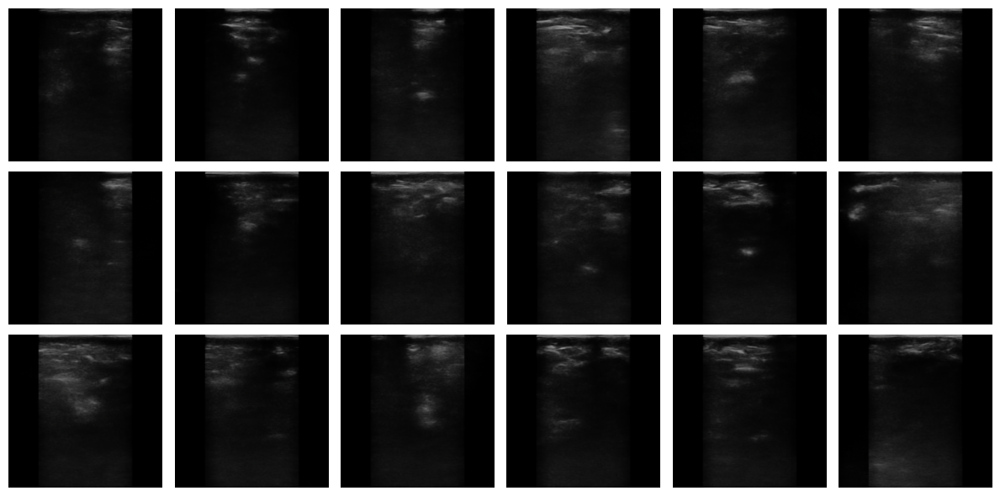

Epoch 1/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0446 - i_loss: 0.0699
Epoch 2/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0451 - i_loss: 0.0699
Epoch 3/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0452 - i_loss: 0.0698
Epoch 4/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0458 - i_loss: 0.0700
Epoch 5/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0454 - i_loss: 0.0716
Epoch 6/10
204/204 [==============================] - 83s 408ms/step - n_loss: 0.0448 - i_loss: 0.0689
Epoch 7/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0458 - i_loss: 0.0681
Epoch 8/10
204/204 [==============================] - 84s 409ms/step - n_loss: 0.0446 - i_loss: 0.0711
Epoch 9/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0462 - i_loss: 0.0705
Epoch 10/10
204/204 [==============================] - 83s 409ms/step - n

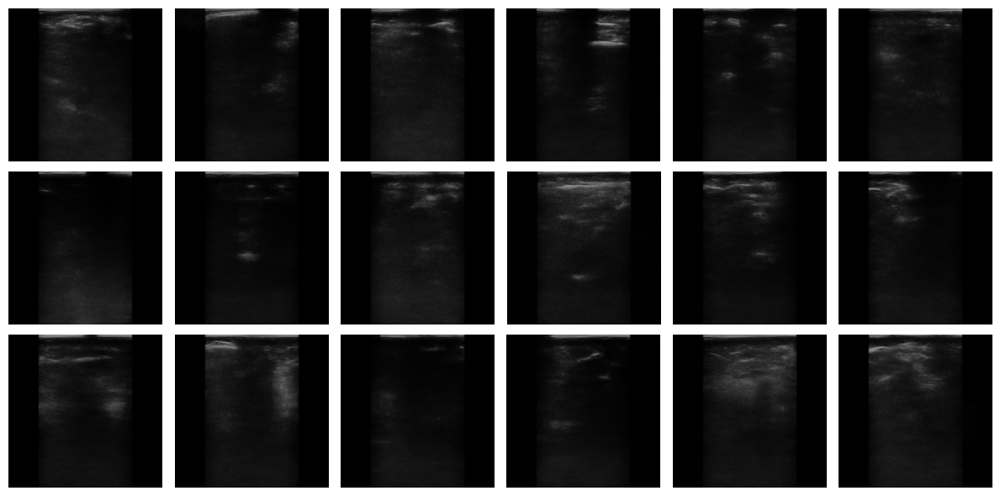

Epoch 1/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0450 - i_loss: 0.0701
Epoch 2/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0451 - i_loss: 0.0708
Epoch 3/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0449 - i_loss: 0.0711
Epoch 4/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0451 - i_loss: 0.0687
Epoch 5/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0457 - i_loss: 0.0690
Epoch 6/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0449 - i_loss: 0.0693
Epoch 7/10
204/204 [==============================] - 83s 408ms/step - n_loss: 0.0450 - i_loss: 0.0703
Epoch 8/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0452 - i_loss: 0.0701
Epoch 9/10
204/204 [==============================] - 83s 408ms/step - n_loss: 0.0447 - i_loss: 0.0706
Epoch 10/10
204/204 [==============================] - 83s 409ms/step - n

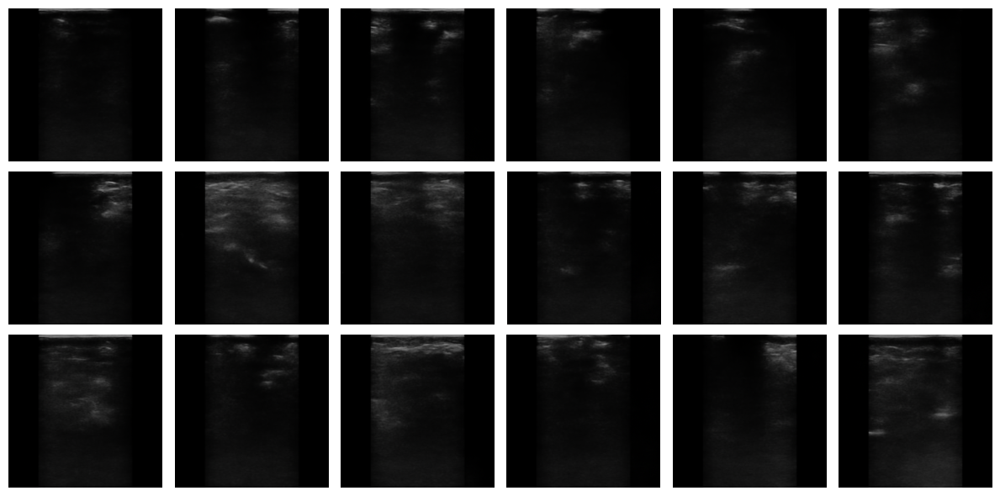

Epoch 1/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0448 - i_loss: 0.0707
Epoch 2/10
204/204 [==============================] - 84s 410ms/step - n_loss: 0.0452 - i_loss: 0.0697
Epoch 3/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0453 - i_loss: 0.0698
Epoch 4/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0452 - i_loss: 0.0695
Epoch 5/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0454 - i_loss: 0.0708
Epoch 6/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0454 - i_loss: 0.0712
Epoch 7/10
204/204 [==============================] - 83s 408ms/step - n_loss: 0.0453 - i_loss: 0.0704
Epoch 8/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0440 - i_loss: 0.0722
Epoch 9/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0457 - i_loss: 0.0690
Epoch 10/10
204/204 [==============================] - 83s 408ms/step - n

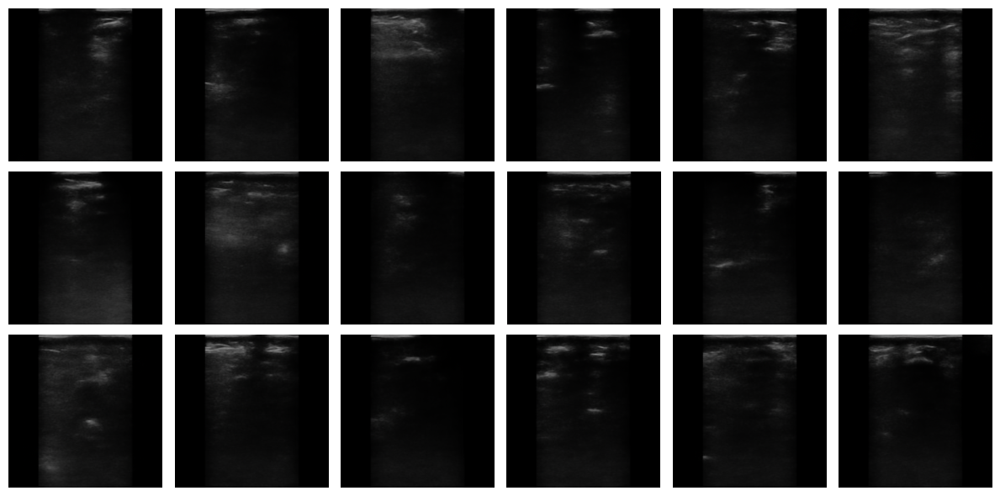

Epoch 1/10
204/204 [==============================] - 83s 408ms/step - n_loss: 0.0452 - i_loss: 0.0674
Epoch 2/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0450 - i_loss: 0.0708
Epoch 3/10
204/204 [==============================] - 83s 408ms/step - n_loss: 0.0449 - i_loss: 0.0682
Epoch 4/10
204/204 [==============================] - 83s 408ms/step - n_loss: 0.0451 - i_loss: 0.0690
Epoch 5/10
204/204 [==============================] - 83s 408ms/step - n_loss: 0.0454 - i_loss: 0.0717
Epoch 6/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0448 - i_loss: 0.0694
Epoch 7/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0455 - i_loss: 0.0696
Epoch 8/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0451 - i_loss: 0.0705
Epoch 9/10
204/204 [==============================] - 83s 408ms/step - n_loss: 0.0450 - i_loss: 0.0707
Epoch 10/10
204/204 [==============================] - 83s 409ms/step - n

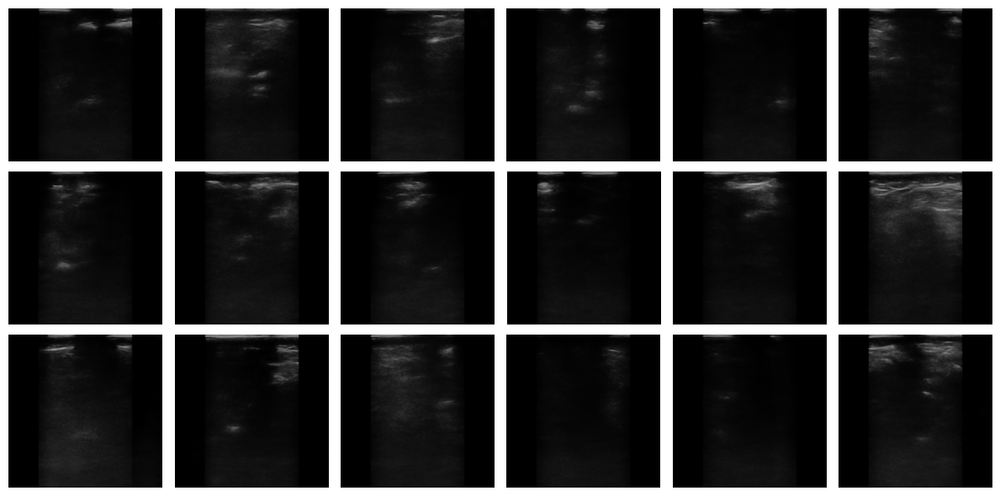

Epoch 1/10
204/204 [==============================] - 83s 408ms/step - n_loss: 0.0451 - i_loss: 0.0707
Epoch 2/10
204/204 [==============================] - 84s 409ms/step - n_loss: 0.0453 - i_loss: 0.0702
Epoch 3/10
204/204 [==============================] - 83s 408ms/step - n_loss: 0.0445 - i_loss: 0.0699
Epoch 4/10
204/204 [==============================] - 84s 410ms/step - n_loss: 0.0450 - i_loss: 0.0710
Epoch 5/10
204/204 [==============================] - 84s 409ms/step - n_loss: 0.0448 - i_loss: 0.0706
Epoch 6/10
204/204 [==============================] - 84s 410ms/step - n_loss: 0.0457 - i_loss: 0.0684
Epoch 7/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0455 - i_loss: 0.0687
Epoch 8/10
204/204 [==============================] - 84s 411ms/step - n_loss: 0.0452 - i_loss: 0.0706
Epoch 9/10
204/204 [==============================] - 84s 411ms/step - n_loss: 0.0449 - i_loss: 0.0694
Epoch 10/10
204/204 [==============================] - 83s 408ms/step - n

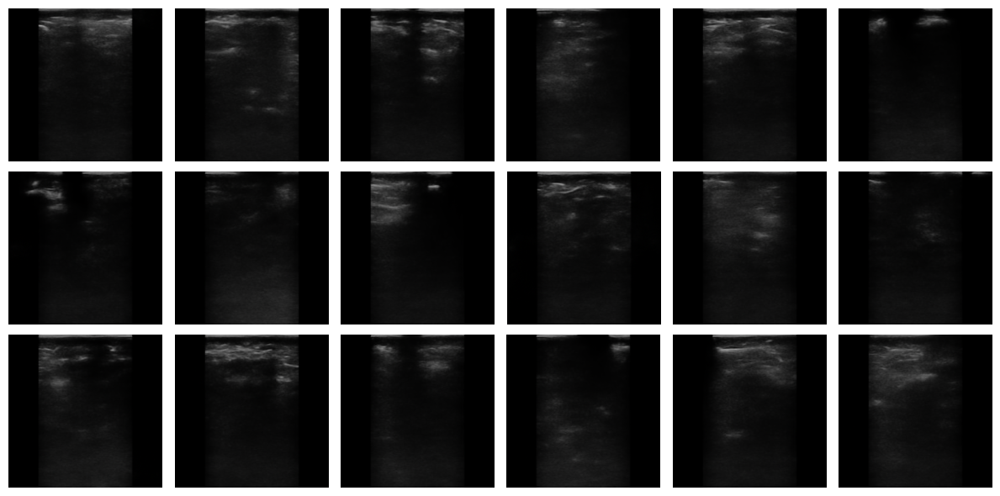

Epoch 1/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0445 - i_loss: 0.0703
Epoch 2/10
204/204 [==============================] - 84s 409ms/step - n_loss: 0.0457 - i_loss: 0.0706
Epoch 3/10
204/204 [==============================] - 84s 410ms/step - n_loss: 0.0449 - i_loss: 0.0702
Epoch 4/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0460 - i_loss: 0.0691
Epoch 5/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0448 - i_loss: 0.0715
Epoch 6/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0446 - i_loss: 0.0696
Epoch 7/10
204/204 [==============================] - 83s 408ms/step - n_loss: 0.0461 - i_loss: 0.0707
Epoch 8/10
204/204 [==============================] - 83s 408ms/step - n_loss: 0.0448 - i_loss: 0.0715
Epoch 9/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0449 - i_loss: 0.0689
Epoch 10/10
204/204 [==============================] - 83s 408ms/step - n

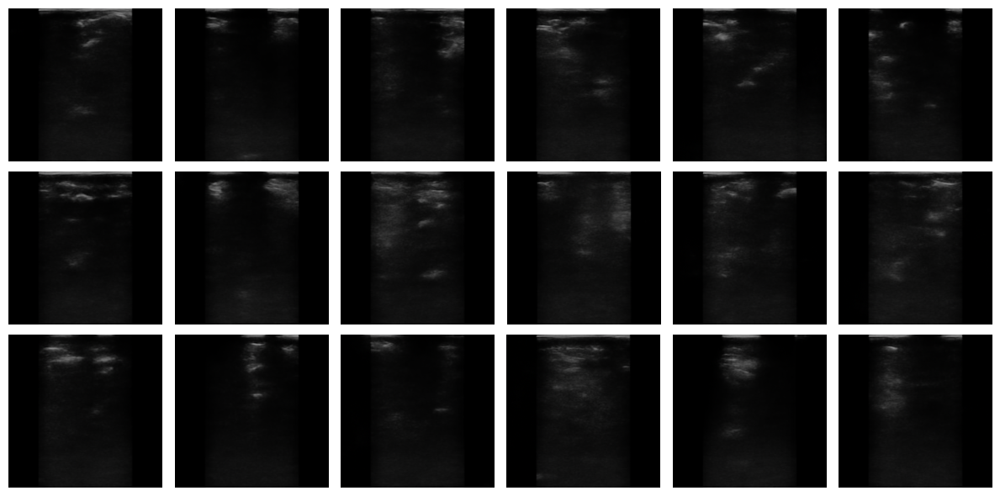

Epoch 1/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0450 - i_loss: 0.0698
Epoch 2/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0452 - i_loss: 0.0695
Epoch 3/10
204/204 [==============================] - 84s 410ms/step - n_loss: 0.0451 - i_loss: 0.0697
Epoch 4/10
204/204 [==============================] - 84s 409ms/step - n_loss: 0.0442 - i_loss: 0.0718
Epoch 5/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0442 - i_loss: 0.0708
Epoch 6/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0448 - i_loss: 0.0699
Epoch 7/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0465 - i_loss: 0.0698
Epoch 8/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0446 - i_loss: 0.0713
Epoch 9/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0448 - i_loss: 0.0684
Epoch 10/10
204/204 [==============================] - 83s 409ms/step - n

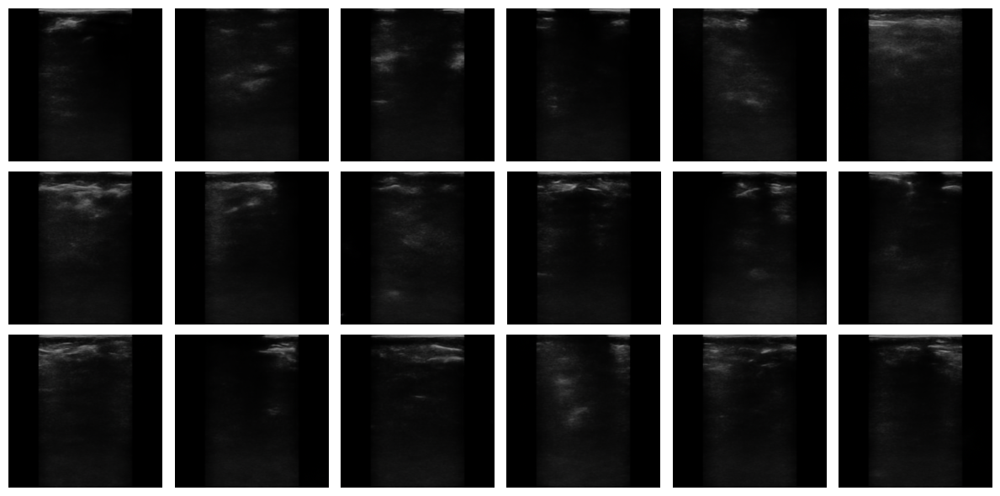

Epoch 1/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0445 - i_loss: 0.0688
Epoch 2/10
204/204 [==============================] - 83s 408ms/step - n_loss: 0.0449 - i_loss: 0.0692
Epoch 3/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0449 - i_loss: 0.0722
Epoch 4/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0447 - i_loss: 0.0718
Epoch 5/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0458 - i_loss: 0.0686
Epoch 6/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0442 - i_loss: 0.0705
Epoch 7/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0453 - i_loss: 0.0707
Epoch 8/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0463 - i_loss: 0.0703
Epoch 9/10
204/204 [==============================] - 84s 409ms/step - n_loss: 0.0447 - i_loss: 0.0722
Epoch 10/10
204/204 [==============================] - 83s 409ms/step - n

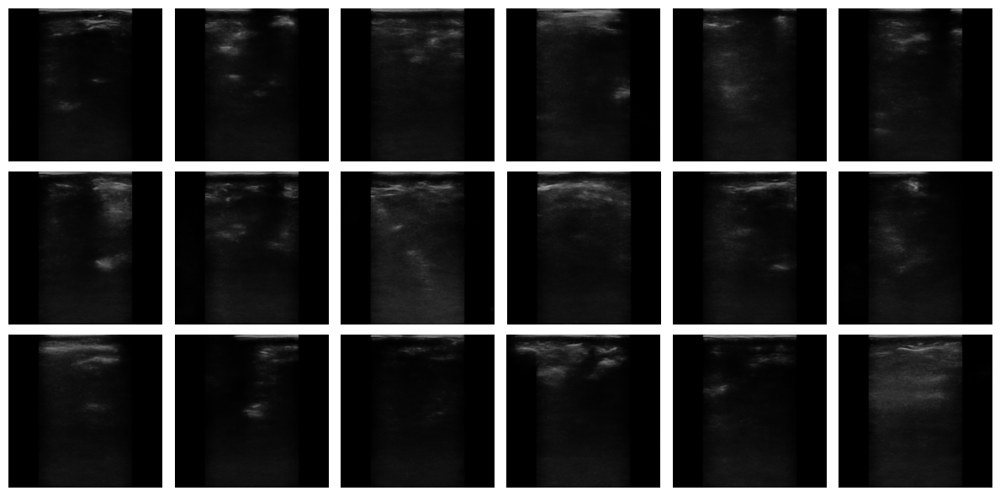

Epoch 1/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0450 - i_loss: 0.0698
Epoch 2/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0441 - i_loss: 0.0714
Epoch 3/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0444 - i_loss: 0.0703
Epoch 4/10
204/204 [==============================] - 84s 409ms/step - n_loss: 0.0461 - i_loss: 0.0673
Epoch 5/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0453 - i_loss: 0.0701
Epoch 6/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0447 - i_loss: 0.0719
Epoch 7/10
204/204 [==============================] - 84s 409ms/step - n_loss: 0.0446 - i_loss: 0.0707
Epoch 8/10
204/204 [==============================] - 84s 410ms/step - n_loss: 0.0454 - i_loss: 0.0684
Epoch 9/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0460 - i_loss: 0.0699
Epoch 10/10
204/204 [==============================] - 83s 409ms/step - n

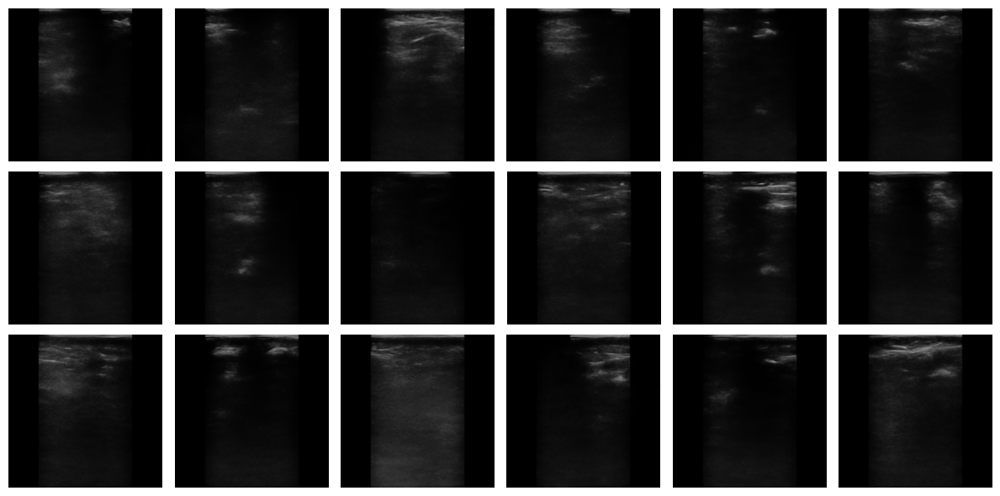

Epoch 1/10
204/204 [==============================] - 83s 408ms/step - n_loss: 0.0453 - i_loss: 0.0710
Epoch 2/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0451 - i_loss: 0.0694
Epoch 3/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0451 - i_loss: 0.0689
Epoch 4/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0448 - i_loss: 0.0708
Epoch 5/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0452 - i_loss: 0.0695
Epoch 6/10
204/204 [==============================] - 84s 410ms/step - n_loss: 0.0446 - i_loss: 0.0730
Epoch 7/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0446 - i_loss: 0.0700
Epoch 8/10
204/204 [==============================] - 84s 410ms/step - n_loss: 0.0452 - i_loss: 0.0715
Epoch 9/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0448 - i_loss: 0.0694
Epoch 10/10
204/204 [==============================] - 83s 409ms/step - n

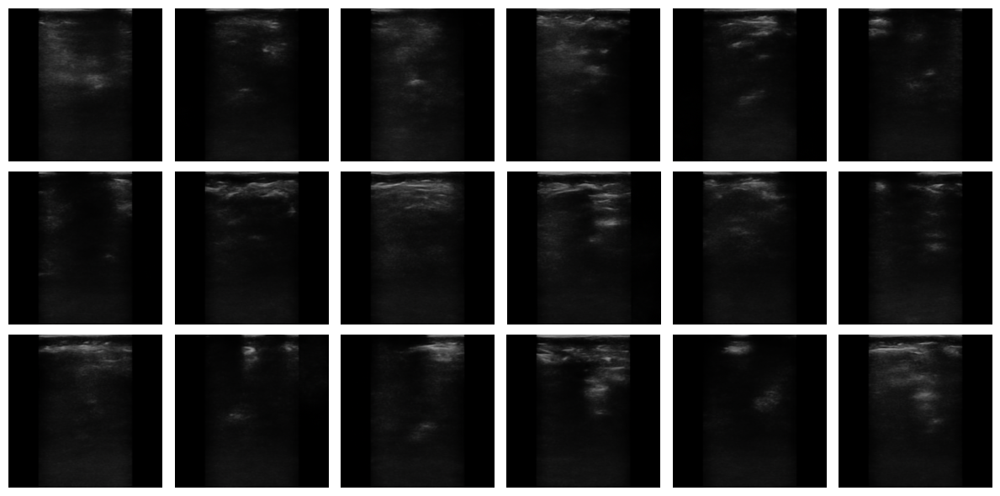

Epoch 1/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0444 - i_loss: 0.0695
Epoch 2/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0449 - i_loss: 0.0700
Epoch 3/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0452 - i_loss: 0.0704
Epoch 4/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0450 - i_loss: 0.0707
Epoch 5/10
204/204 [==============================] - 84s 409ms/step - n_loss: 0.0454 - i_loss: 0.0714
Epoch 6/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0456 - i_loss: 0.0707
Epoch 7/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0450 - i_loss: 0.0698
Epoch 8/10
204/204 [==============================] - 84s 409ms/step - n_loss: 0.0450 - i_loss: 0.0683
Epoch 9/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0444 - i_loss: 0.0701
Epoch 10/10
204/204 [==============================] - 83s 409ms/step - n

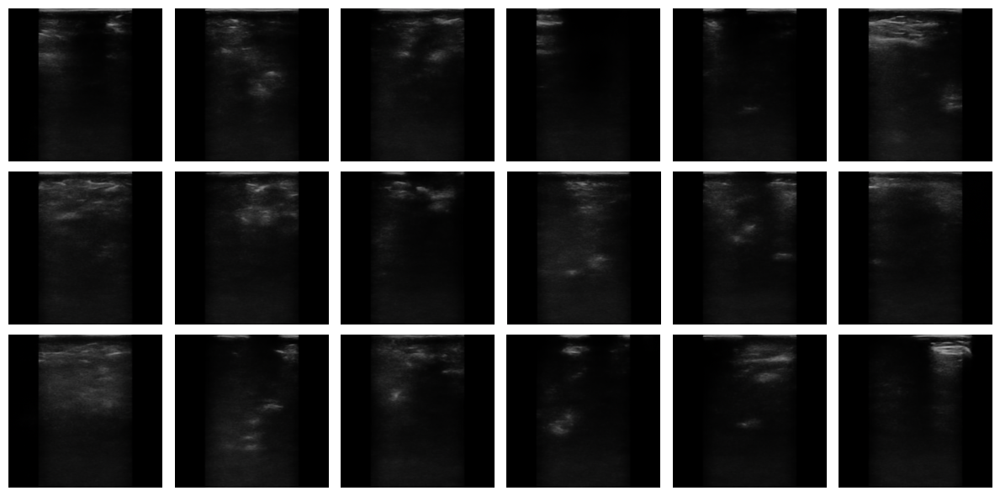

Epoch 1/10
204/204 [==============================] - 83s 408ms/step - n_loss: 0.0457 - i_loss: 0.0705
Epoch 2/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0451 - i_loss: 0.0700
Epoch 3/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0451 - i_loss: 0.0700
Epoch 4/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0450 - i_loss: 0.0685
Epoch 5/10
204/204 [==============================] - 83s 408ms/step - n_loss: 0.0463 - i_loss: 0.0670
Epoch 6/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0448 - i_loss: 0.0726
Epoch 7/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0454 - i_loss: 0.0698
Epoch 8/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0450 - i_loss: 0.0698
Epoch 9/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0449 - i_loss: 0.0699
Epoch 10/10
204/204 [==============================] - 83s 408ms/step - n

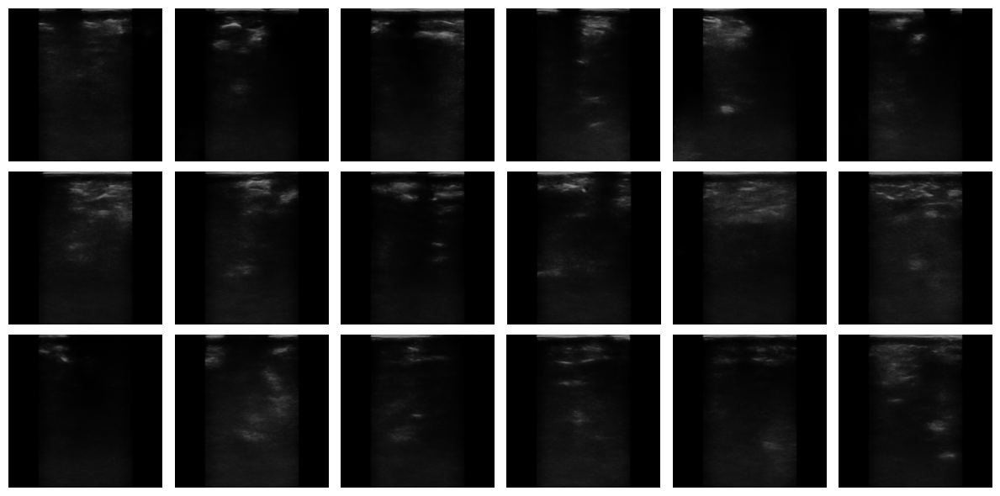

Epoch 1/10
204/204 [==============================] - 83s 408ms/step - n_loss: 0.0445 - i_loss: 0.0713
Epoch 2/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0449 - i_loss: 0.0701
Epoch 3/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0459 - i_loss: 0.0717
Epoch 4/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0456 - i_loss: 0.0704
Epoch 5/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0448 - i_loss: 0.0688
Epoch 6/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0450 - i_loss: 0.0695
Epoch 7/10
204/204 [==============================] - 83s 408ms/step - n_loss: 0.0444 - i_loss: 0.0711
Epoch 8/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0447 - i_loss: 0.0688
Epoch 9/10
204/204 [==============================] - 83s 408ms/step - n_loss: 0.0449 - i_loss: 0.0720
Epoch 10/10
204/204 [==============================] - 83s 408ms/step - n

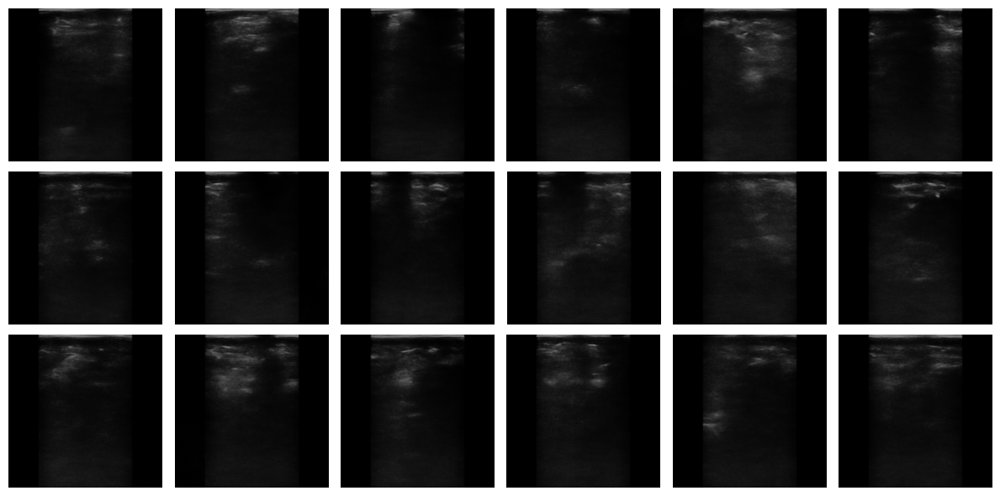

Epoch 1/10
204/204 [==============================] - 83s 408ms/step - n_loss: 0.0455 - i_loss: 0.0689
Epoch 2/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0449 - i_loss: 0.0721
Epoch 3/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0449 - i_loss: 0.0702
Epoch 4/10
204/204 [==============================] - 84s 409ms/step - n_loss: 0.0448 - i_loss: 0.0708
Epoch 5/10
204/204 [==============================] - 84s 410ms/step - n_loss: 0.0453 - i_loss: 0.0703
Epoch 6/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0455 - i_loss: 0.0697
Epoch 7/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0453 - i_loss: 0.0704
Epoch 8/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0449 - i_loss: 0.0697
Epoch 9/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0451 - i_loss: 0.0709
Epoch 10/10
204/204 [==============================] - 83s 409ms/step - n

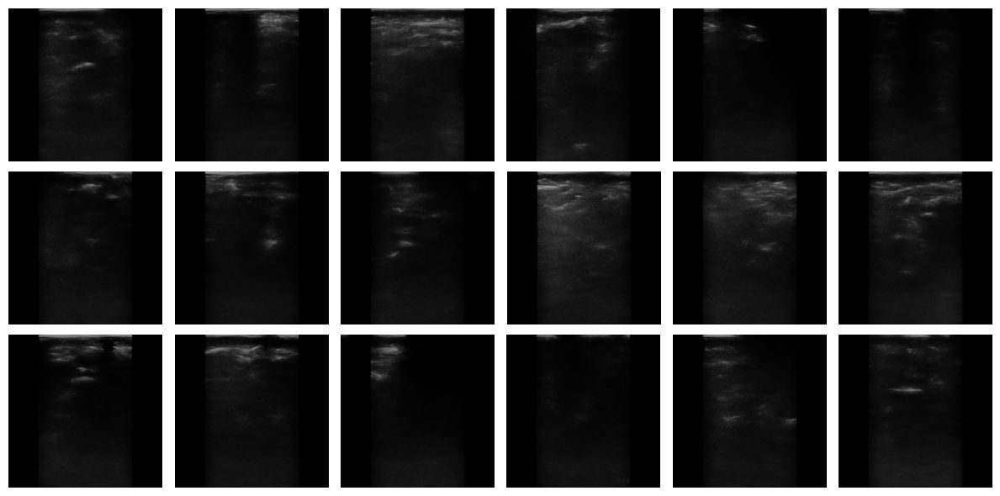

Epoch 1/10
204/204 [==============================] - 83s 406ms/step - n_loss: 0.0447 - i_loss: 0.0697
Epoch 2/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0449 - i_loss: 0.0694
Epoch 3/10
204/204 [==============================] - 84s 410ms/step - n_loss: 0.0449 - i_loss: 0.0701
Epoch 4/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0451 - i_loss: 0.0702
Epoch 5/10
204/204 [==============================] - 84s 409ms/step - n_loss: 0.0448 - i_loss: 0.0717
Epoch 6/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0457 - i_loss: 0.0692
Epoch 7/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0457 - i_loss: 0.0692
Epoch 8/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0450 - i_loss: 0.0696
Epoch 9/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0447 - i_loss: 0.0704
Epoch 10/10
204/204 [==============================] - 83s 409ms/step - n

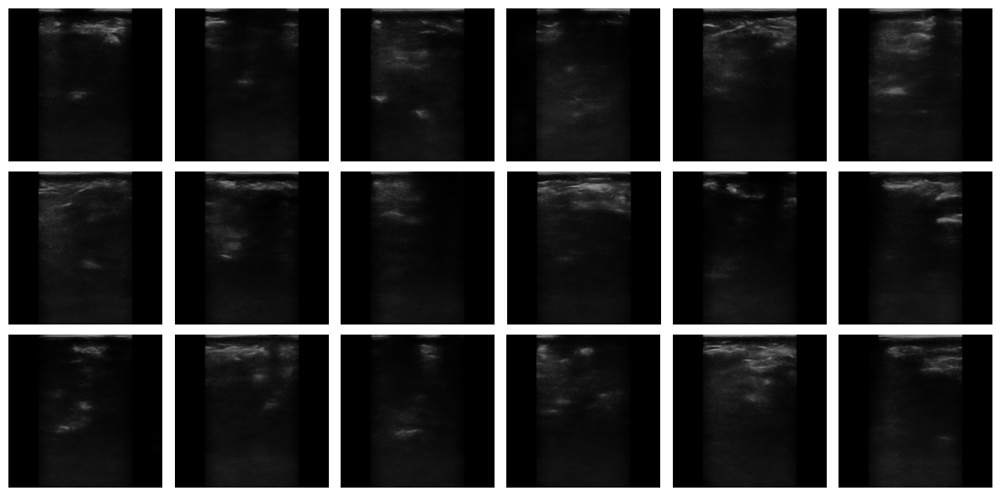

Epoch 1/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0445 - i_loss: 0.0707
Epoch 2/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0448 - i_loss: 0.0719
Epoch 3/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0450 - i_loss: 0.0696
Epoch 4/10
204/204 [==============================] - 84s 410ms/step - n_loss: 0.0455 - i_loss: 0.0690
Epoch 5/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0449 - i_loss: 0.0697
Epoch 6/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0450 - i_loss: 0.0704
Epoch 7/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0452 - i_loss: 0.0685
Epoch 8/10
204/204 [==============================] - 83s 408ms/step - n_loss: 0.0458 - i_loss: 0.0685
Epoch 9/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0453 - i_loss: 0.0681
Epoch 10/10
204/204 [==============================] - 84s 409ms/step - n

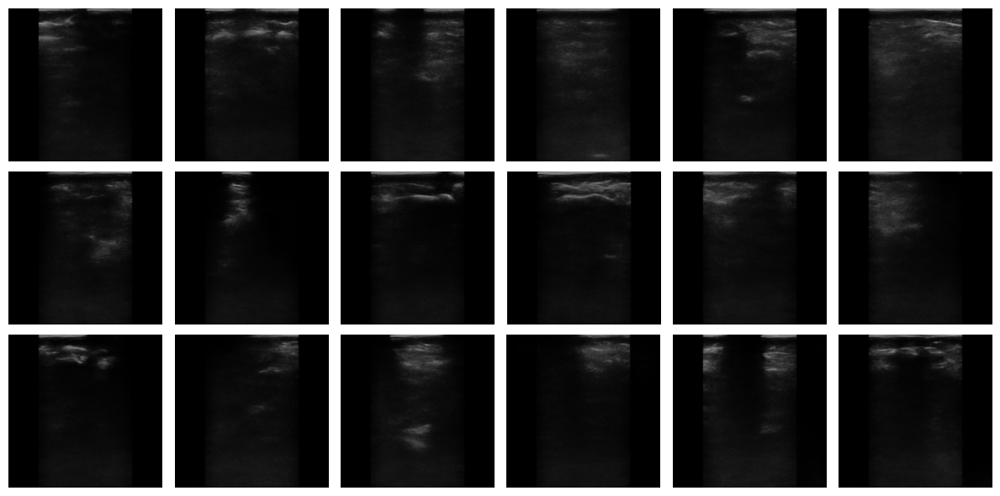

Epoch 1/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0452 - i_loss: 0.0690
Epoch 2/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0449 - i_loss: 0.0699
Epoch 3/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0443 - i_loss: 0.0689
Epoch 4/10
204/204 [==============================] - 84s 410ms/step - n_loss: 0.0452 - i_loss: 0.0717
Epoch 5/10
204/204 [==============================] - 84s 410ms/step - n_loss: 0.0448 - i_loss: 0.0704
Epoch 6/10
204/204 [==============================] - 84s 409ms/step - n_loss: 0.0460 - i_loss: 0.0699
Epoch 7/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0448 - i_loss: 0.0690
Epoch 8/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0455 - i_loss: 0.0697
Epoch 9/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0457 - i_loss: 0.0689
Epoch 10/10
204/204 [==============================] - 83s 408ms/step - n

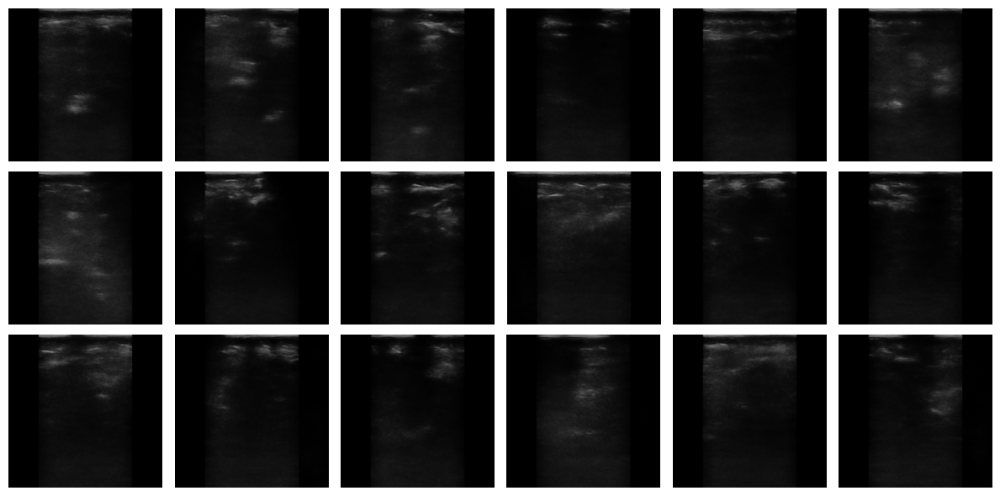

Epoch 1/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0452 - i_loss: 0.0703
Epoch 2/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0453 - i_loss: 0.0690
Epoch 3/10
204/204 [==============================] - 84s 409ms/step - n_loss: 0.0455 - i_loss: 0.0704
Epoch 4/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0450 - i_loss: 0.0687
Epoch 5/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0457 - i_loss: 0.0696
Epoch 6/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0450 - i_loss: 0.0720
Epoch 7/10
204/204 [==============================] - 83s 408ms/step - n_loss: 0.0452 - i_loss: 0.0694
Epoch 8/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0459 - i_loss: 0.0710
Epoch 9/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0460 - i_loss: 0.0687
Epoch 10/10
204/204 [==============================] - 83s 409ms/step - n

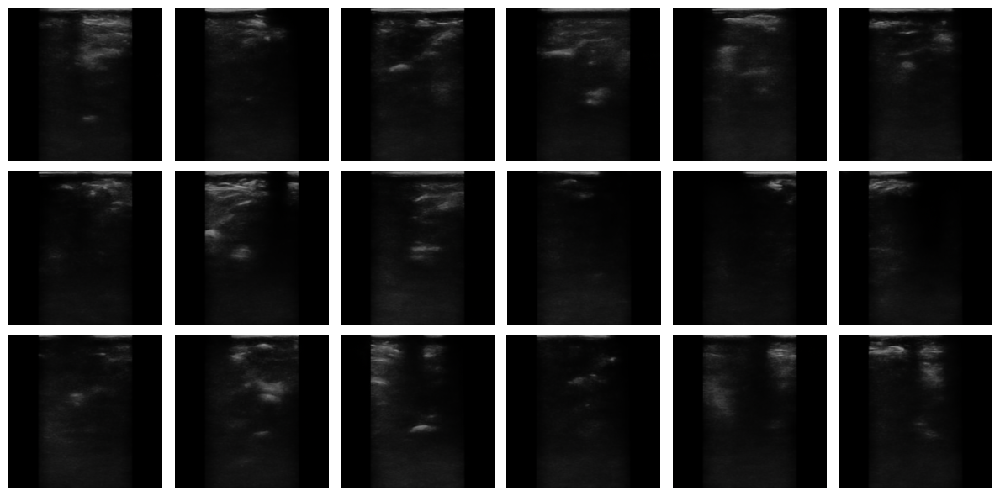

Epoch 1/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0452 - i_loss: 0.0698
Epoch 2/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0451 - i_loss: 0.0698
Epoch 3/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0451 - i_loss: 0.0688
Epoch 4/10
204/204 [==============================] - 84s 410ms/step - n_loss: 0.0450 - i_loss: 0.0700
Epoch 5/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0450 - i_loss: 0.0710
Epoch 6/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0449 - i_loss: 0.0711
Epoch 7/10
204/204 [==============================] - 84s 410ms/step - n_loss: 0.0446 - i_loss: 0.0704
Epoch 8/10
204/204 [==============================] - 83s 408ms/step - n_loss: 0.0455 - i_loss: 0.0701
Epoch 9/10
204/204 [==============================] - 83s 408ms/step - n_loss: 0.0447 - i_loss: 0.0709
Epoch 10/10
204/204 [==============================] - 83s 408ms/step - n

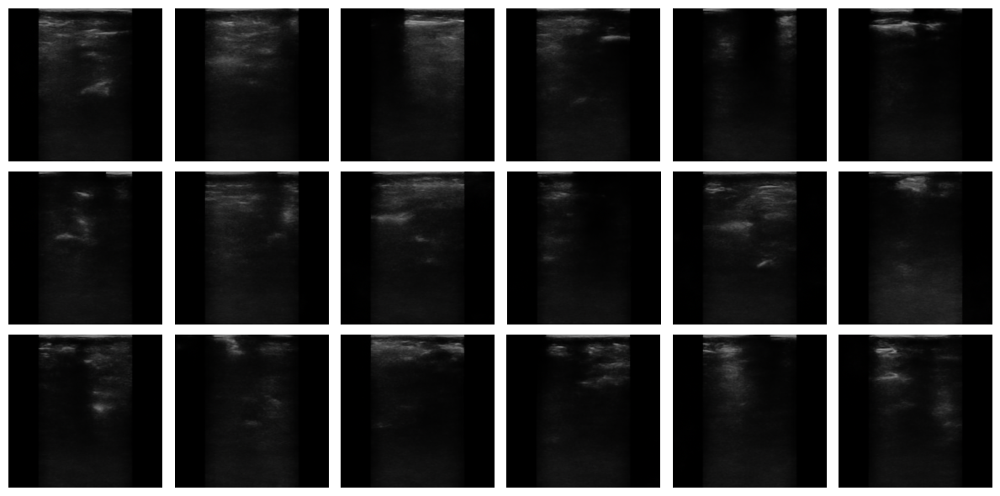

Epoch 1/10
204/204 [==============================] - 83s 408ms/step - n_loss: 0.0454 - i_loss: 0.0694
Epoch 2/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0453 - i_loss: 0.0685
Epoch 3/10
204/204 [==============================] - 83s 408ms/step - n_loss: 0.0446 - i_loss: 0.0733
Epoch 4/10
204/204 [==============================] - 83s 408ms/step - n_loss: 0.0456 - i_loss: 0.0695
Epoch 5/10
204/204 [==============================] - 83s 408ms/step - n_loss: 0.0443 - i_loss: 0.0713
Epoch 6/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0456 - i_loss: 0.0668
Epoch 7/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0452 - i_loss: 0.0705
Epoch 8/10
204/204 [==============================] - 83s 408ms/step - n_loss: 0.0445 - i_loss: 0.0704
Epoch 9/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0446 - i_loss: 0.0691
Epoch 10/10
204/204 [==============================] - 83s 409ms/step - n

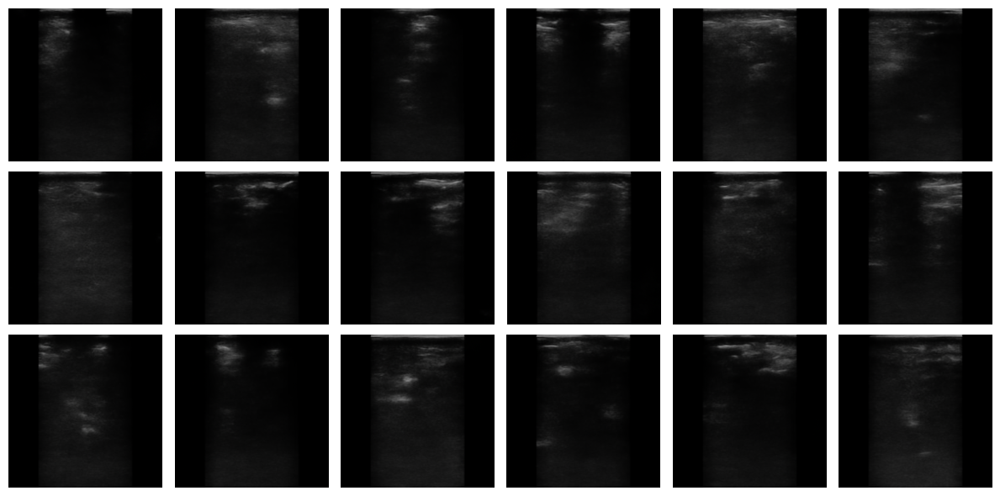

Epoch 1/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0451 - i_loss: 0.0697
Epoch 2/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0448 - i_loss: 0.0711
Epoch 3/10
204/204 [==============================] - 84s 410ms/step - n_loss: 0.0448 - i_loss: 0.0700
Epoch 4/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0452 - i_loss: 0.0699
Epoch 5/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0454 - i_loss: 0.0702
Epoch 6/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0450 - i_loss: 0.0687
Epoch 7/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0441 - i_loss: 0.0709
Epoch 8/10
204/204 [==============================] - 83s 408ms/step - n_loss: 0.0454 - i_loss: 0.0702
Epoch 9/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0457 - i_loss: 0.0706
Epoch 10/10
204/204 [==============================] - 84s 412ms/step - n

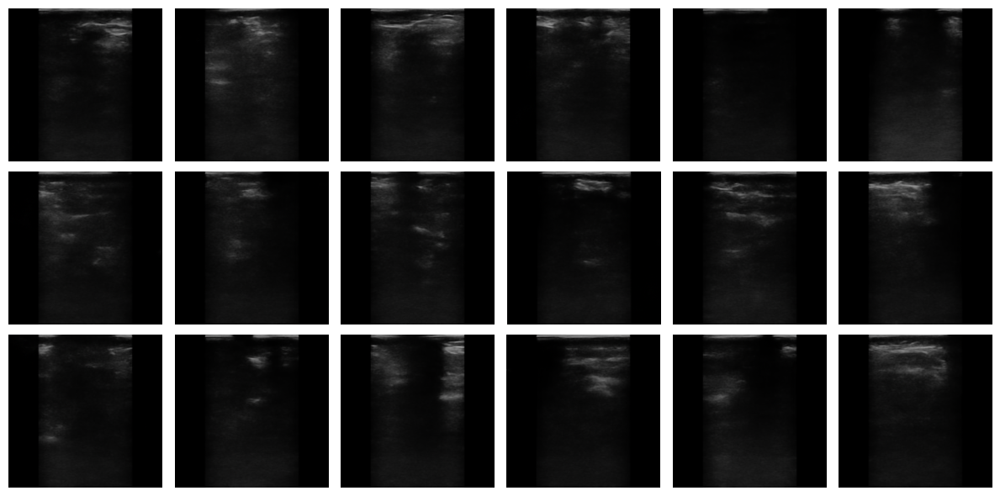

Epoch 1/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0446 - i_loss: 0.0719
Epoch 2/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0448 - i_loss: 0.0692
Epoch 3/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0448 - i_loss: 0.0692
Epoch 4/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0449 - i_loss: 0.0714
Epoch 5/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0450 - i_loss: 0.0692
Epoch 6/10
204/204 [==============================] - 83s 408ms/step - n_loss: 0.0450 - i_loss: 0.0694
Epoch 7/10
204/204 [==============================] - 83s 408ms/step - n_loss: 0.0450 - i_loss: 0.0707
Epoch 8/10
204/204 [==============================] - 83s 408ms/step - n_loss: 0.0454 - i_loss: 0.0690
Epoch 9/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0446 - i_loss: 0.0721
Epoch 10/10
204/204 [==============================] - 83s 409ms/step - n

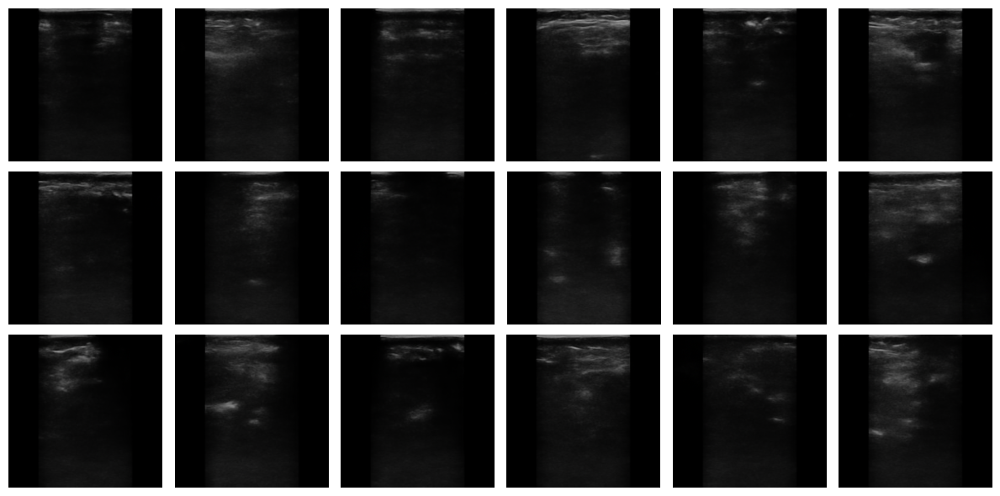

Epoch 1/10
204/204 [==============================] - 83s 408ms/step - n_loss: 0.0452 - i_loss: 0.0698
Epoch 2/10
204/204 [==============================] - 84s 409ms/step - n_loss: 0.0452 - i_loss: 0.0695
Epoch 3/10
204/204 [==============================] - 83s 408ms/step - n_loss: 0.0454 - i_loss: 0.0695
Epoch 4/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0464 - i_loss: 0.0693
Epoch 5/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0444 - i_loss: 0.0700
Epoch 6/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0448 - i_loss: 0.0704
Epoch 7/10
204/204 [==============================] - 83s 408ms/step - n_loss: 0.0440 - i_loss: 0.0703
Epoch 8/10
204/204 [==============================] - 83s 408ms/step - n_loss: 0.0452 - i_loss: 0.0701
Epoch 9/10
204/204 [==============================] - 83s 408ms/step - n_loss: 0.0451 - i_loss: 0.0688
Epoch 10/10
204/204 [==============================] - 83s 408ms/step - n

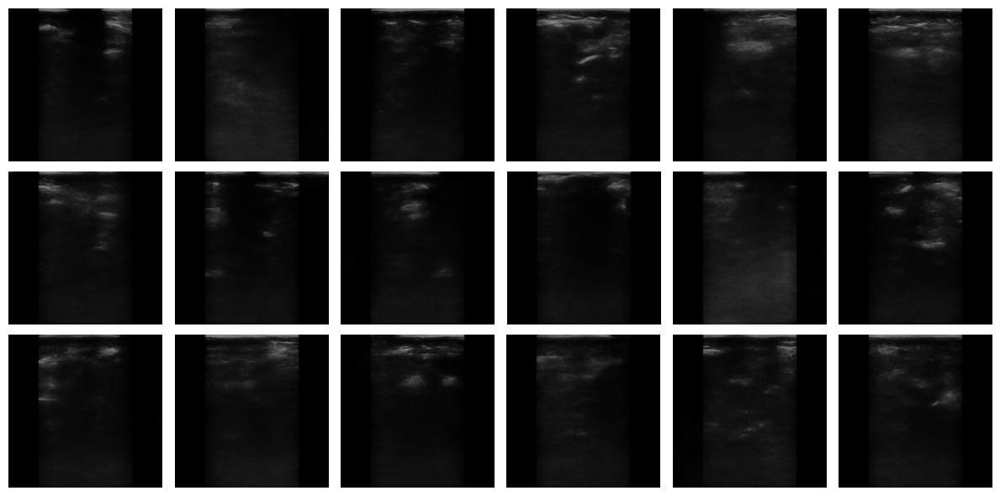

Epoch 1/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0453 - i_loss: 0.0695
Epoch 2/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0458 - i_loss: 0.0699
Epoch 3/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0447 - i_loss: 0.0695
Epoch 4/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0448 - i_loss: 0.0715
Epoch 5/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0450 - i_loss: 0.0684
Epoch 6/10
204/204 [==============================] - 83s 408ms/step - n_loss: 0.0452 - i_loss: 0.0709
Epoch 7/10
204/204 [==============================] - 83s 408ms/step - n_loss: 0.0448 - i_loss: 0.0700
Epoch 8/10
204/204 [==============================] - 83s 408ms/step - n_loss: 0.0448 - i_loss: 0.0700
Epoch 9/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0453 - i_loss: 0.0709
Epoch 10/10
204/204 [==============================] - 83s 408ms/step - n

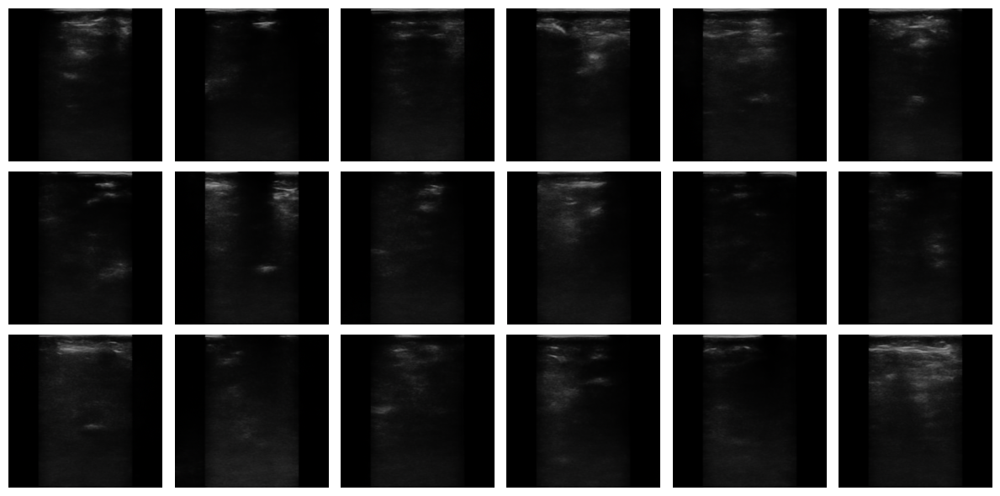

Epoch 1/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0459 - i_loss: 0.0702
Epoch 2/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0447 - i_loss: 0.0714
Epoch 3/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0451 - i_loss: 0.0691
Epoch 4/10
204/204 [==============================] - 84s 410ms/step - n_loss: 0.0456 - i_loss: 0.0700
Epoch 5/10
204/204 [==============================] - 84s 409ms/step - n_loss: 0.0459 - i_loss: 0.0686
Epoch 6/10
204/204 [==============================] - 83s 408ms/step - n_loss: 0.0455 - i_loss: 0.0684
Epoch 7/10
204/204 [==============================] - 83s 408ms/step - n_loss: 0.0440 - i_loss: 0.0722
Epoch 8/10
204/204 [==============================] - 83s 408ms/step - n_loss: 0.0449 - i_loss: 0.0711
Epoch 9/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0451 - i_loss: 0.0704
Epoch 10/10
204/204 [==============================] - 83s 409ms/step - n

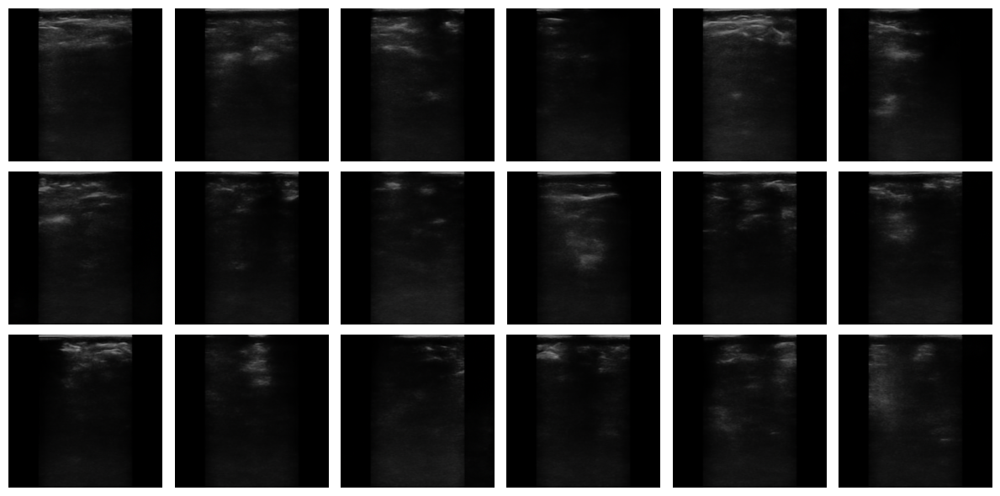

Epoch 1/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0446 - i_loss: 0.0708
Epoch 2/10
204/204 [==============================] - 84s 409ms/step - n_loss: 0.0449 - i_loss: 0.0709
Epoch 3/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0444 - i_loss: 0.0703
Epoch 4/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0463 - i_loss: 0.0703
Epoch 5/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0456 - i_loss: 0.0705
Epoch 6/10
204/204 [==============================] - 83s 408ms/step - n_loss: 0.0449 - i_loss: 0.0705
Epoch 7/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0453 - i_loss: 0.0692
Epoch 8/10
204/204 [==============================] - 83s 408ms/step - n_loss: 0.0450 - i_loss: 0.0690
Epoch 9/10
204/204 [==============================] - 83s 408ms/step - n_loss: 0.0453 - i_loss: 0.0695
Epoch 10/10
204/204 [==============================] - 83s 409ms/step - n

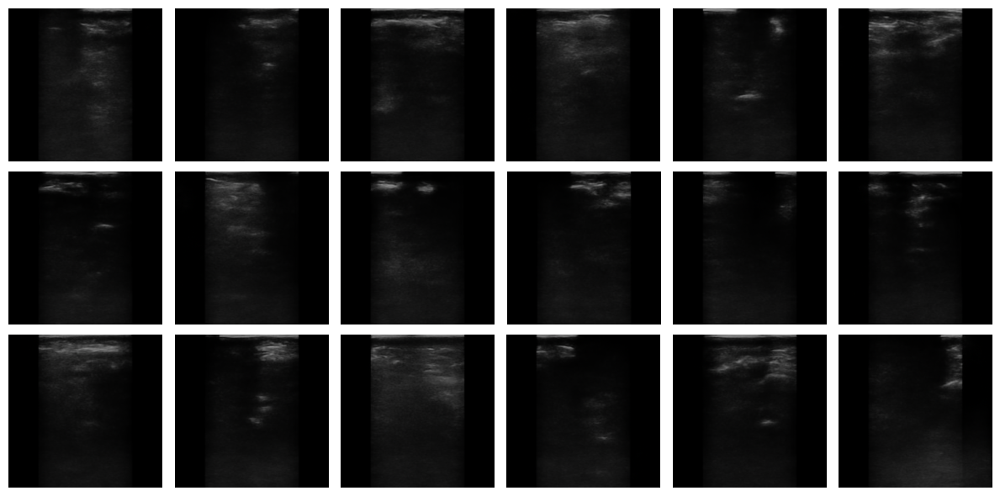

Epoch 1/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0454 - i_loss: 0.0699
Epoch 2/10
204/204 [==============================] - 84s 409ms/step - n_loss: 0.0452 - i_loss: 0.0701
Epoch 3/10
204/204 [==============================] - 84s 409ms/step - n_loss: 0.0452 - i_loss: 0.0692
Epoch 4/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0455 - i_loss: 0.0692
Epoch 5/10
204/204 [==============================] - 83s 408ms/step - n_loss: 0.0451 - i_loss: 0.0701
Epoch 6/10
204/204 [==============================] - 83s 408ms/step - n_loss: 0.0457 - i_loss: 0.0693
Epoch 7/10
204/204 [==============================] - 83s 408ms/step - n_loss: 0.0453 - i_loss: 0.0690
Epoch 8/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0454 - i_loss: 0.0704
Epoch 9/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0453 - i_loss: 0.0696
Epoch 10/10
204/204 [==============================] - 83s 408ms/step - n

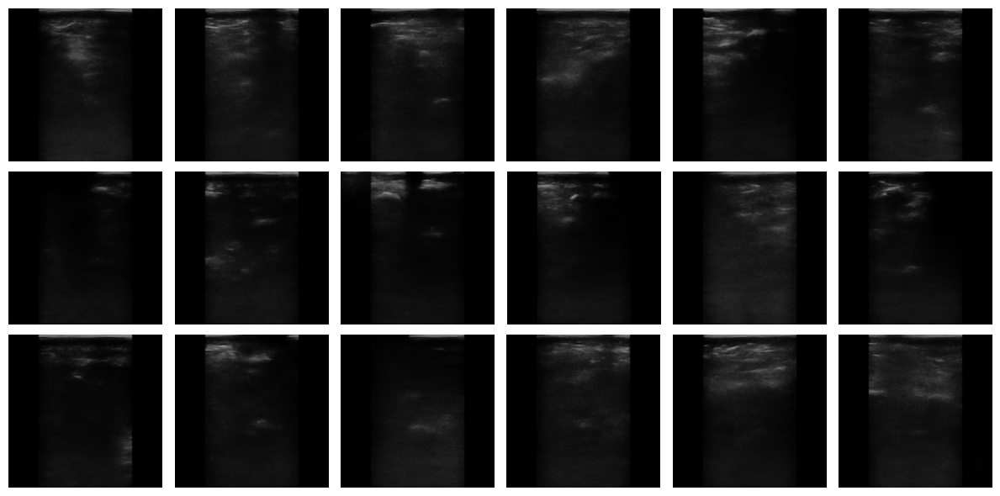

Epoch 1/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0441 - i_loss: 0.0710
Epoch 2/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0449 - i_loss: 0.0692
Epoch 3/10
204/204 [==============================] - 84s 409ms/step - n_loss: 0.0458 - i_loss: 0.0693
Epoch 4/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0452 - i_loss: 0.0698
Epoch 5/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0450 - i_loss: 0.0695
Epoch 6/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0450 - i_loss: 0.0706
Epoch 7/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0453 - i_loss: 0.0693
Epoch 8/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0452 - i_loss: 0.0712
Epoch 9/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0445 - i_loss: 0.0701
Epoch 10/10
204/204 [==============================] - 83s 409ms/step - n

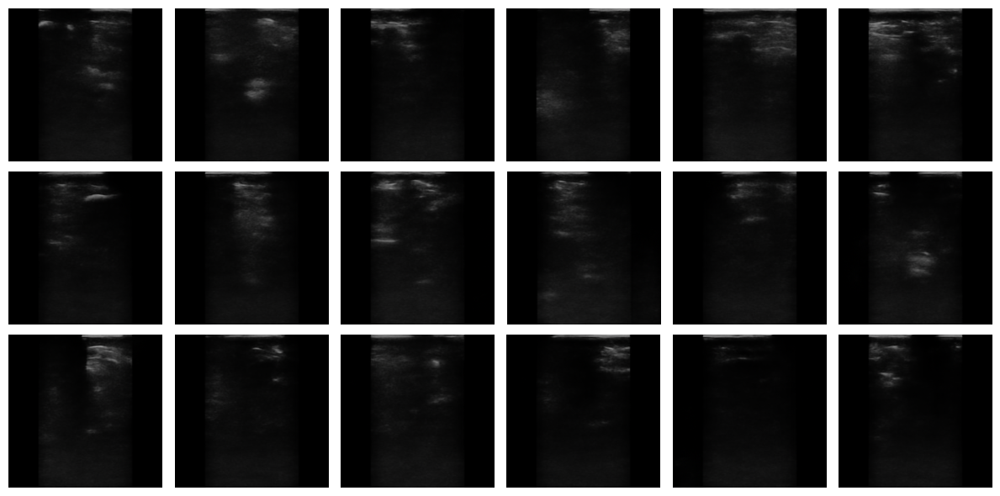

Epoch 1/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0451 - i_loss: 0.0694
Epoch 2/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0446 - i_loss: 0.0699
Epoch 3/10
204/204 [==============================] - 83s 408ms/step - n_loss: 0.0458 - i_loss: 0.0701
Epoch 4/10
204/204 [==============================] - 83s 408ms/step - n_loss: 0.0453 - i_loss: 0.0712
Epoch 5/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0452 - i_loss: 0.0699
Epoch 6/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0453 - i_loss: 0.0700
Epoch 7/10
204/204 [==============================] - 83s 408ms/step - n_loss: 0.0446 - i_loss: 0.0698
Epoch 8/10
204/204 [==============================] - 83s 408ms/step - n_loss: 0.0448 - i_loss: 0.0691
Epoch 9/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0460 - i_loss: 0.0686
Epoch 10/10
204/204 [==============================] - 83s 409ms/step - n

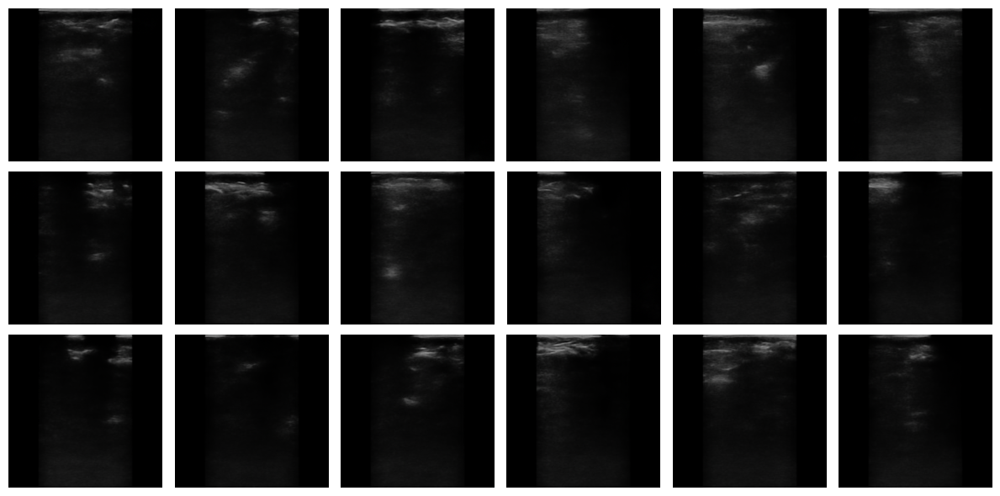

Epoch 1/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0447 - i_loss: 0.0694
Epoch 2/10
204/204 [==============================] - 84s 410ms/step - n_loss: 0.0453 - i_loss: 0.0701
Epoch 3/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0455 - i_loss: 0.0699
Epoch 4/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0453 - i_loss: 0.0709
Epoch 5/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0442 - i_loss: 0.0702
Epoch 6/10
204/204 [==============================] - 83s 408ms/step - n_loss: 0.0450 - i_loss: 0.0695
Epoch 7/10
204/204 [==============================] - 83s 408ms/step - n_loss: 0.0437 - i_loss: 0.0705
Epoch 8/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0457 - i_loss: 0.0702
Epoch 9/10
204/204 [==============================] - 83s 408ms/step - n_loss: 0.0450 - i_loss: 0.0708
Epoch 10/10
204/204 [==============================] - 83s 408ms/step - n

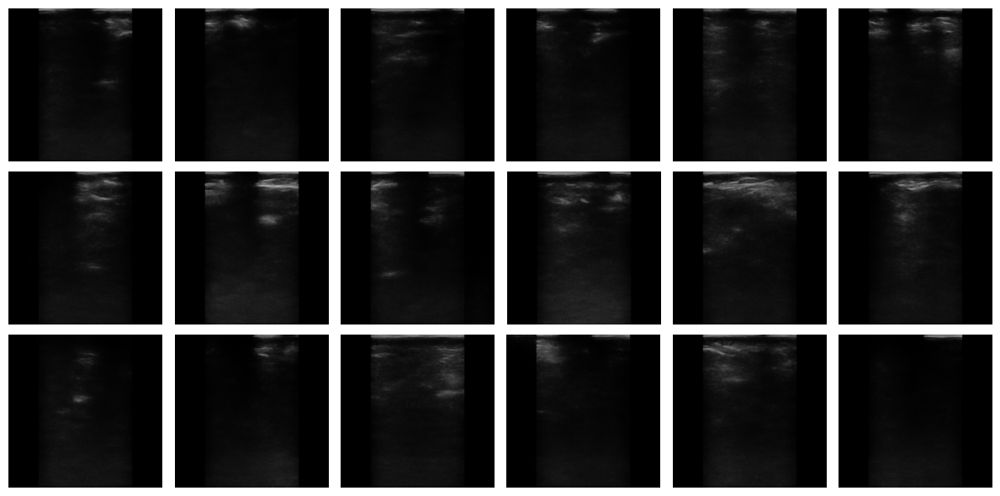

Epoch 1/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0451 - i_loss: 0.0695
Epoch 2/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0458 - i_loss: 0.0707
Epoch 3/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0450 - i_loss: 0.0687
Epoch 4/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0448 - i_loss: 0.0700
Epoch 5/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0451 - i_loss: 0.0707
Epoch 6/10
204/204 [==============================] - 83s 408ms/step - n_loss: 0.0457 - i_loss: 0.0702
Epoch 7/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0450 - i_loss: 0.0706
Epoch 8/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0443 - i_loss: 0.0700
Epoch 9/10
204/204 [==============================] - 83s 408ms/step - n_loss: 0.0458 - i_loss: 0.0679
Epoch 10/10
204/204 [==============================] - 83s 409ms/step - n

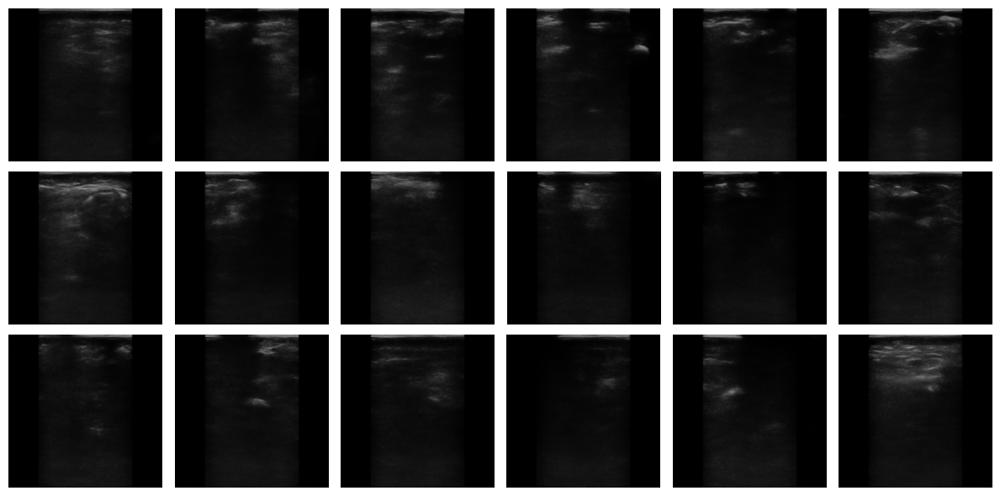

Epoch 1/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0447 - i_loss: 0.0698
Epoch 2/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0455 - i_loss: 0.0695
Epoch 3/10
204/204 [==============================] - 84s 410ms/step - n_loss: 0.0444 - i_loss: 0.0718
Epoch 4/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0458 - i_loss: 0.0686
Epoch 5/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0451 - i_loss: 0.0693
Epoch 6/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0456 - i_loss: 0.0698
Epoch 7/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0444 - i_loss: 0.0717
Epoch 8/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0452 - i_loss: 0.0709
Epoch 9/10
204/204 [==============================] - 83s 408ms/step - n_loss: 0.0460 - i_loss: 0.0687
Epoch 10/10
204/204 [==============================] - 83s 408ms/step - n

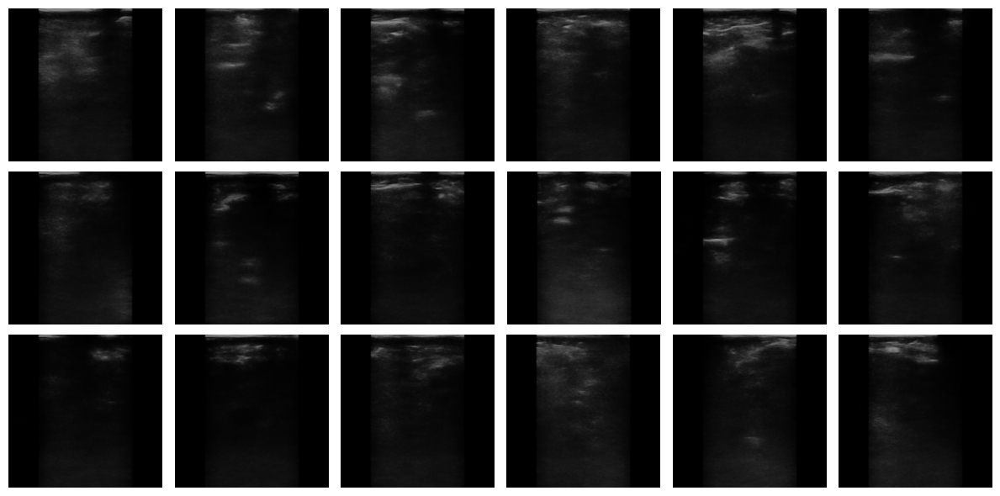

Epoch 1/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0450 - i_loss: 0.0683
Epoch 2/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0455 - i_loss: 0.0689
Epoch 3/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0459 - i_loss: 0.0698
Epoch 4/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0456 - i_loss: 0.0701
Epoch 5/10
204/204 [==============================] - 83s 408ms/step - n_loss: 0.0453 - i_loss: 0.0699
Epoch 6/10
204/204 [==============================] - 83s 408ms/step - n_loss: 0.0449 - i_loss: 0.0693
Epoch 7/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0444 - i_loss: 0.0713
Epoch 8/10
204/204 [==============================] - 83s 408ms/step - n_loss: 0.0456 - i_loss: 0.0687
Epoch 9/10
204/204 [==============================] - 83s 408ms/step - n_loss: 0.0456 - i_loss: 0.0692
Epoch 10/10
204/204 [==============================] - 83s 409ms/step - n

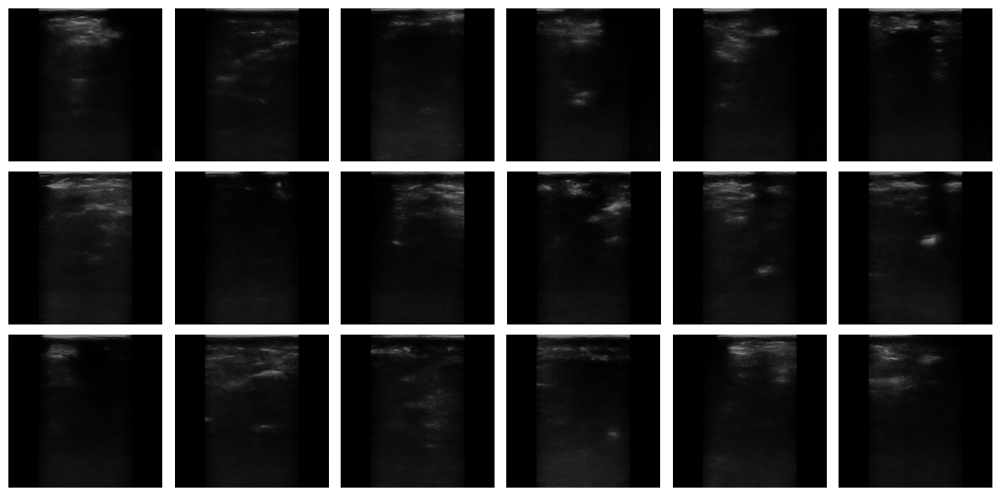

Epoch 1/10
204/204 [==============================] - 83s 408ms/step - n_loss: 0.0450 - i_loss: 0.0701
Epoch 2/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0453 - i_loss: 0.0702
Epoch 3/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0454 - i_loss: 0.0710
Epoch 4/10
204/204 [==============================] - 83s 408ms/step - n_loss: 0.0451 - i_loss: 0.0685
Epoch 5/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0452 - i_loss: 0.0700
Epoch 6/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0454 - i_loss: 0.0698
Epoch 7/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0448 - i_loss: 0.0710
Epoch 8/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0447 - i_loss: 0.0714
Epoch 9/10
204/204 [==============================] - 84s 409ms/step - n_loss: 0.0451 - i_loss: 0.0685
Epoch 10/10
204/204 [==============================] - 83s 409ms/step - n

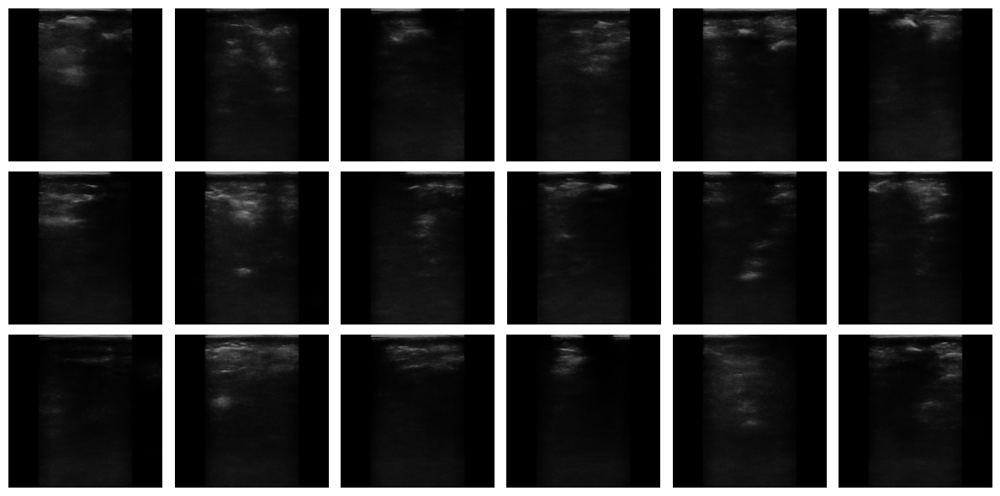

Epoch 1/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0455 - i_loss: 0.0696
Epoch 2/10
204/204 [==============================] - 84s 409ms/step - n_loss: 0.0455 - i_loss: 0.0702
Epoch 3/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0451 - i_loss: 0.0690
Epoch 4/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0453 - i_loss: 0.0685
Epoch 5/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0456 - i_loss: 0.0680
Epoch 6/10
204/204 [==============================] - 83s 408ms/step - n_loss: 0.0451 - i_loss: 0.0717
Epoch 7/10
204/204 [==============================] - 83s 408ms/step - n_loss: 0.0446 - i_loss: 0.0697
Epoch 8/10
204/204 [==============================] - 83s 408ms/step - n_loss: 0.0450 - i_loss: 0.0694
Epoch 9/10
204/204 [==============================] - 83s 408ms/step - n_loss: 0.0449 - i_loss: 0.0691
Epoch 10/10
204/204 [==============================] - 83s 408ms/step - n

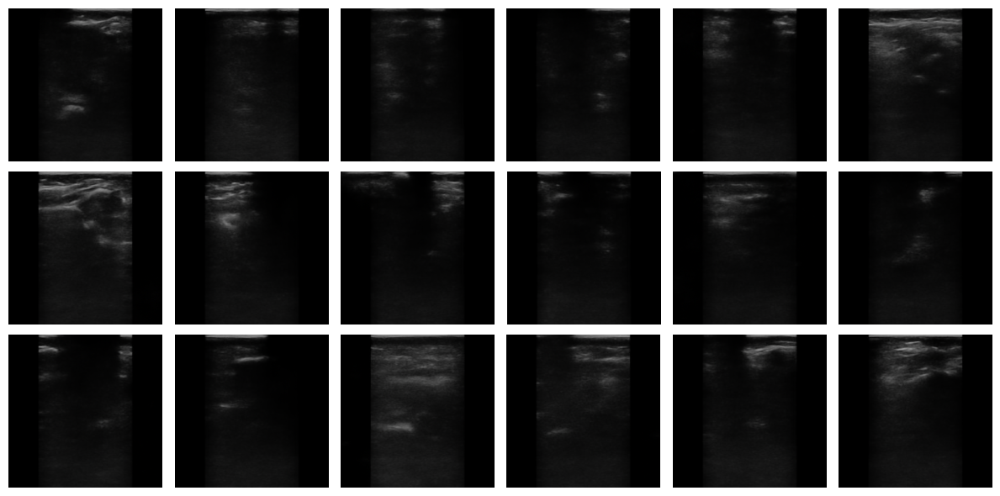

Epoch 1/10
204/204 [==============================] - 83s 408ms/step - n_loss: 0.0457 - i_loss: 0.0706
Epoch 2/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0455 - i_loss: 0.0687
Epoch 3/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0457 - i_loss: 0.0688
Epoch 4/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0451 - i_loss: 0.0681
Epoch 5/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0445 - i_loss: 0.0709
Epoch 6/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0460 - i_loss: 0.0694
Epoch 7/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0450 - i_loss: 0.0700
Epoch 8/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0442 - i_loss: 0.0722
Epoch 9/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0446 - i_loss: 0.0688
Epoch 10/10
204/204 [==============================] - 83s 409ms/step - n

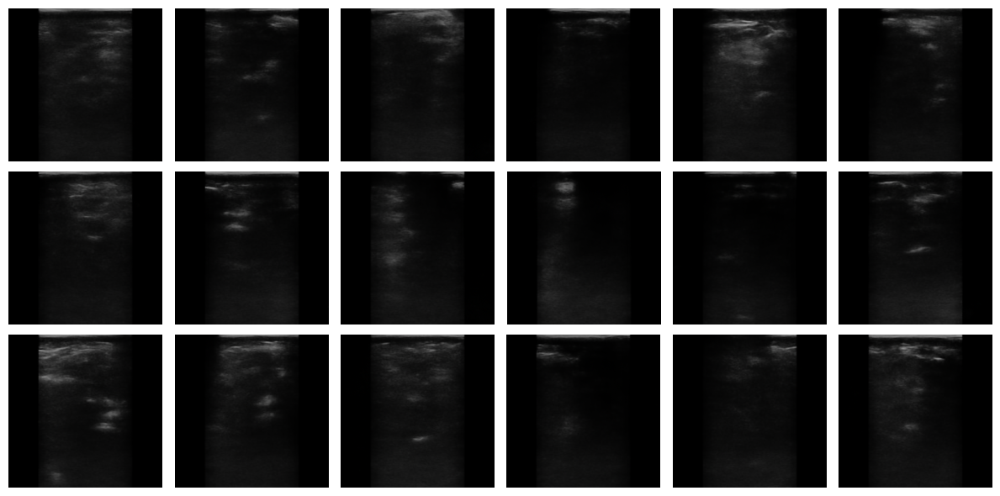

Epoch 1/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0453 - i_loss: 0.0704
Epoch 2/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0450 - i_loss: 0.0682
Epoch 3/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0446 - i_loss: 0.0712
Epoch 4/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0448 - i_loss: 0.0698
Epoch 5/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0458 - i_loss: 0.0694
Epoch 6/10
204/204 [==============================] - 83s 408ms/step - n_loss: 0.0454 - i_loss: 0.0699
Epoch 7/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0458 - i_loss: 0.0687
Epoch 8/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0449 - i_loss: 0.0700
Epoch 9/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0455 - i_loss: 0.0691
Epoch 10/10
204/204 [==============================] - 83s 408ms/step - n

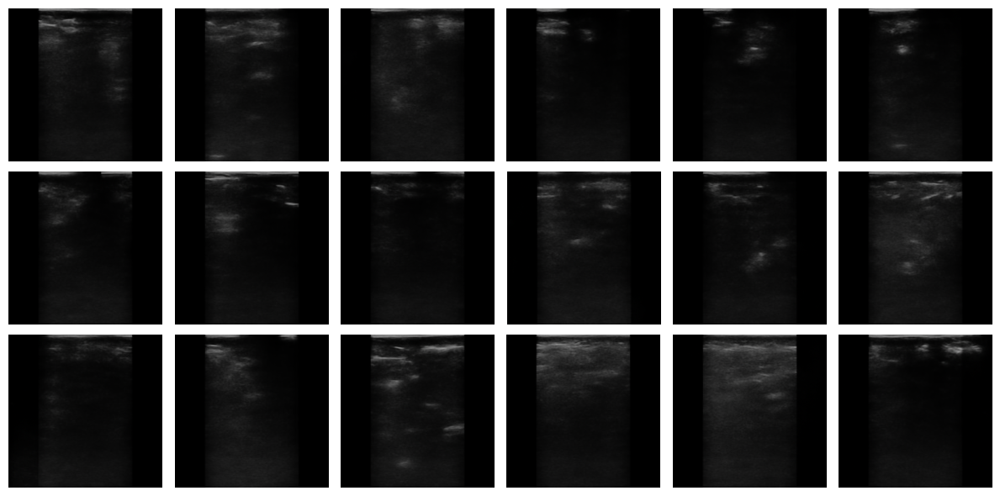

Epoch 1/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0448 - i_loss: 0.0693
Epoch 2/10
204/204 [==============================] - 84s 410ms/step - n_loss: 0.0452 - i_loss: 0.0707
Epoch 3/10
204/204 [==============================] - 84s 410ms/step - n_loss: 0.0450 - i_loss: 0.0689
Epoch 4/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0457 - i_loss: 0.0701
Epoch 5/10
204/204 [==============================] - 84s 410ms/step - n_loss: 0.0446 - i_loss: 0.0711
Epoch 6/10
204/204 [==============================] - 84s 410ms/step - n_loss: 0.0451 - i_loss: 0.0708
Epoch 7/10
204/204 [==============================] - 84s 411ms/step - n_loss: 0.0455 - i_loss: 0.0696
Epoch 8/10
204/204 [==============================] - 84s 413ms/step - n_loss: 0.0444 - i_loss: 0.0706
Epoch 9/10
204/204 [==============================] - 84s 412ms/step - n_loss: 0.0448 - i_loss: 0.0671
Epoch 10/10
204/204 [==============================] - 84s 410ms/step - n

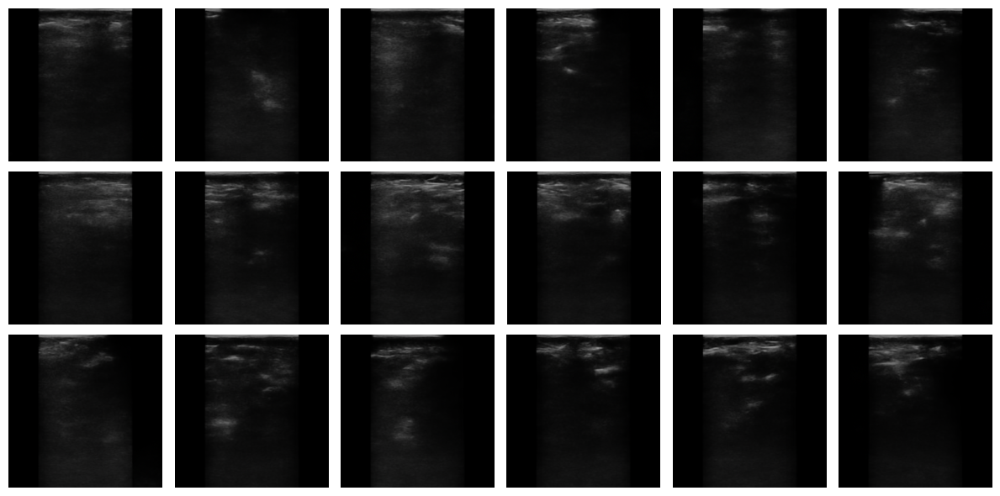

Epoch 1/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0449 - i_loss: 0.0703
Epoch 2/10
204/204 [==============================] - 84s 410ms/step - n_loss: 0.0455 - i_loss: 0.0705
Epoch 3/10
204/204 [==============================] - 84s 409ms/step - n_loss: 0.0457 - i_loss: 0.0695
Epoch 4/10
204/204 [==============================] - 83s 408ms/step - n_loss: 0.0455 - i_loss: 0.0692
Epoch 5/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0450 - i_loss: 0.0700
Epoch 6/10
204/204 [==============================] - 83s 408ms/step - n_loss: 0.0455 - i_loss: 0.0709
Epoch 7/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0454 - i_loss: 0.0697
Epoch 8/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0450 - i_loss: 0.0690
Epoch 9/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0442 - i_loss: 0.0708
Epoch 10/10
204/204 [==============================] - 83s 408ms/step - n

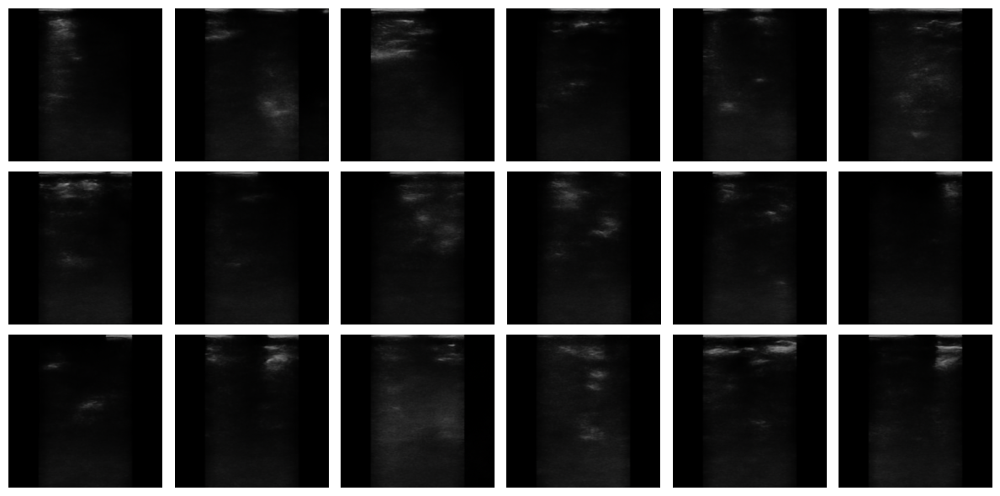

Epoch 1/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0459 - i_loss: 0.0690
Epoch 2/10
204/204 [==============================] - 84s 409ms/step - n_loss: 0.0454 - i_loss: 0.0700
Epoch 3/10
204/204 [==============================] - 84s 410ms/step - n_loss: 0.0441 - i_loss: 0.0698
Epoch 4/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0453 - i_loss: 0.0709
Epoch 5/10
204/204 [==============================] - 83s 408ms/step - n_loss: 0.0446 - i_loss: 0.0690
Epoch 6/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0458 - i_loss: 0.0688
Epoch 7/10
204/204 [==============================] - 83s 408ms/step - n_loss: 0.0452 - i_loss: 0.0712
Epoch 8/10
204/204 [==============================] - 83s 408ms/step - n_loss: 0.0454 - i_loss: 0.0692
Epoch 9/10
204/204 [==============================] - 83s 408ms/step - n_loss: 0.0455 - i_loss: 0.0684
Epoch 10/10
204/204 [==============================] - 83s 408ms/step - n

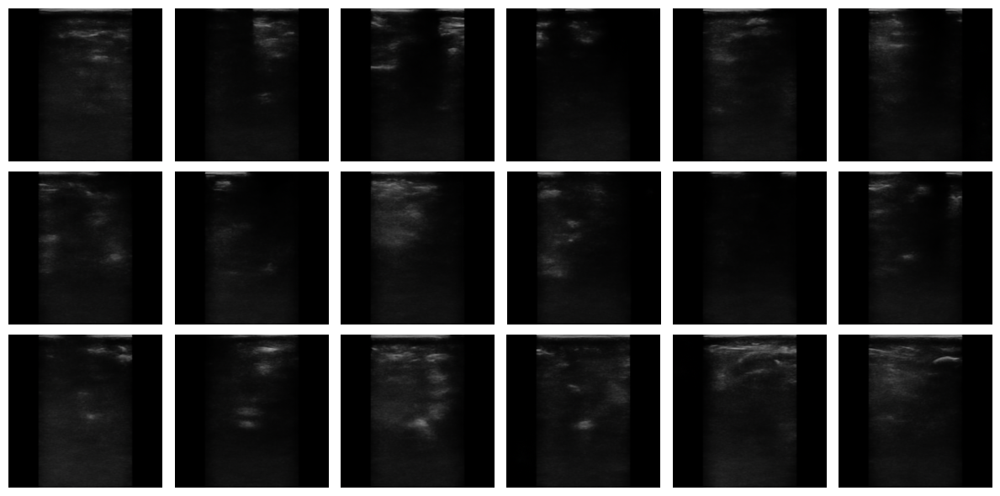

Epoch 1/10
204/204 [==============================] - 83s 408ms/step - n_loss: 0.0442 - i_loss: 0.0697
Epoch 2/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0451 - i_loss: 0.0716
Epoch 3/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0435 - i_loss: 0.0705
Epoch 4/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0451 - i_loss: 0.0688
Epoch 5/10
204/204 [==============================] - 84s 410ms/step - n_loss: 0.0457 - i_loss: 0.0701
Epoch 6/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0447 - i_loss: 0.0694
Epoch 7/10
204/204 [==============================] - 84s 410ms/step - n_loss: 0.0449 - i_loss: 0.0702
Epoch 8/10
204/204 [==============================] - 83s 408ms/step - n_loss: 0.0445 - i_loss: 0.0696
Epoch 9/10
204/204 [==============================] - 83s 408ms/step - n_loss: 0.0450 - i_loss: 0.0705
Epoch 10/10
204/204 [==============================] - 83s 408ms/step - n

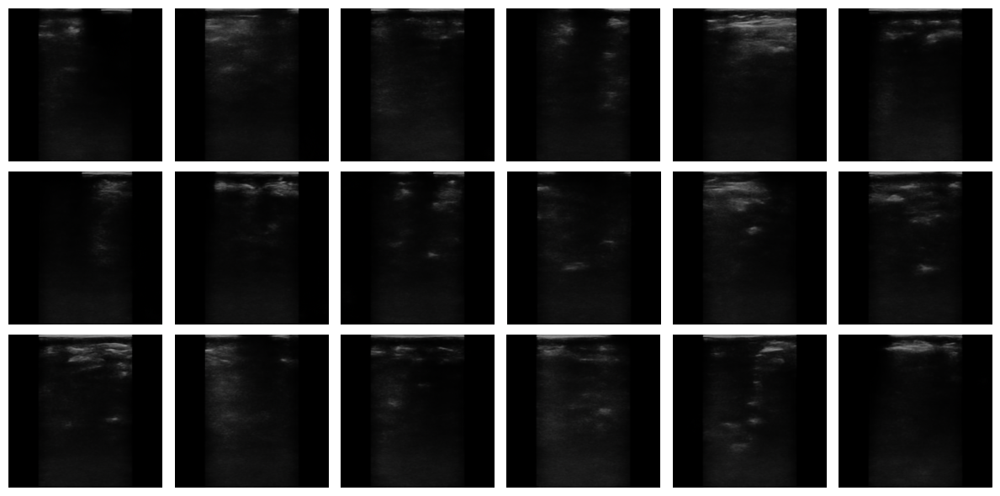

Epoch 1/10
204/204 [==============================] - 83s 408ms/step - n_loss: 0.0448 - i_loss: 0.0711
Epoch 2/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0448 - i_loss: 0.0706
Epoch 3/10
204/204 [==============================] - 84s 410ms/step - n_loss: 0.0458 - i_loss: 0.0709
Epoch 4/10
204/204 [==============================] - 84s 410ms/step - n_loss: 0.0452 - i_loss: 0.0713
Epoch 5/10
204/204 [==============================] - 83s 408ms/step - n_loss: 0.0457 - i_loss: 0.0680
Epoch 6/10
204/204 [==============================] - 83s 408ms/step - n_loss: 0.0452 - i_loss: 0.0704
Epoch 7/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0444 - i_loss: 0.0711
Epoch 8/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0446 - i_loss: 0.0706
Epoch 9/10
204/204 [==============================] - 83s 408ms/step - n_loss: 0.0449 - i_loss: 0.0701
Epoch 10/10
204/204 [==============================] - 83s 409ms/step - n

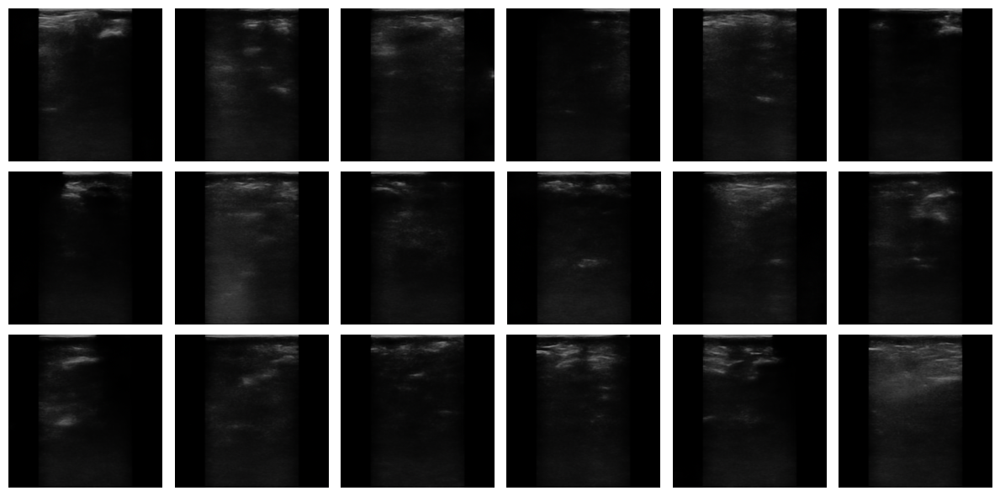

Epoch 1/10
204/204 [==============================] - 83s 408ms/step - n_loss: 0.0457 - i_loss: 0.0677
Epoch 2/10
204/204 [==============================] - 84s 409ms/step - n_loss: 0.0448 - i_loss: 0.0706
Epoch 3/10
204/204 [==============================] - 84s 410ms/step - n_loss: 0.0444 - i_loss: 0.0723
Epoch 4/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0448 - i_loss: 0.0713
Epoch 5/10
204/204 [==============================] - 84s 410ms/step - n_loss: 0.0441 - i_loss: 0.0690
Epoch 6/10
204/204 [==============================] - 84s 410ms/step - n_loss: 0.0447 - i_loss: 0.0710
Epoch 7/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0448 - i_loss: 0.0692
Epoch 8/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0447 - i_loss: 0.0698
Epoch 9/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0448 - i_loss: 0.0689
Epoch 10/10
204/204 [==============================] - 83s 408ms/step - n

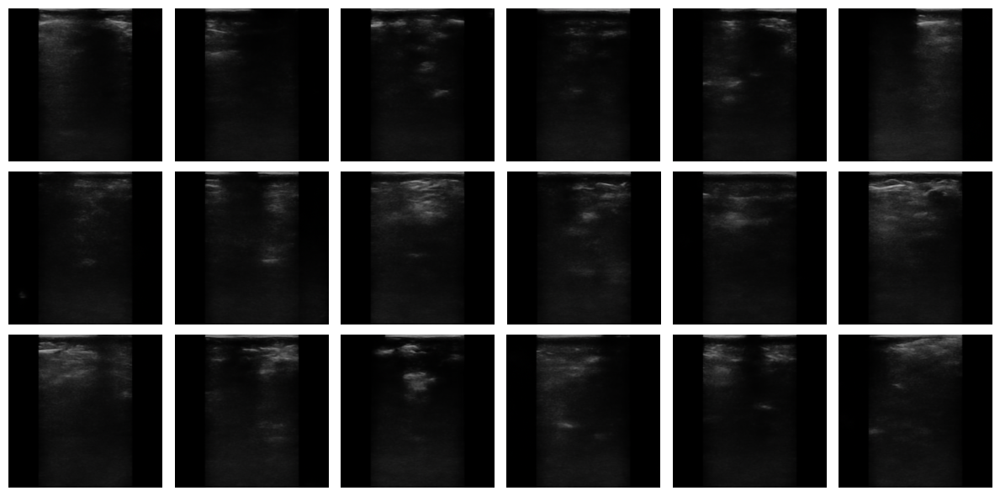

Epoch 1/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0453 - i_loss: 0.0697
Epoch 2/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0449 - i_loss: 0.0710
Epoch 3/10
204/204 [==============================] - 84s 410ms/step - n_loss: 0.0443 - i_loss: 0.0702
Epoch 4/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0448 - i_loss: 0.0701
Epoch 5/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0454 - i_loss: 0.0688
Epoch 6/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0446 - i_loss: 0.0701
Epoch 7/10
204/204 [==============================] - 84s 409ms/step - n_loss: 0.0453 - i_loss: 0.0706
Epoch 8/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0449 - i_loss: 0.0703
Epoch 9/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0445 - i_loss: 0.0697
Epoch 10/10
204/204 [==============================] - 83s 409ms/step - n

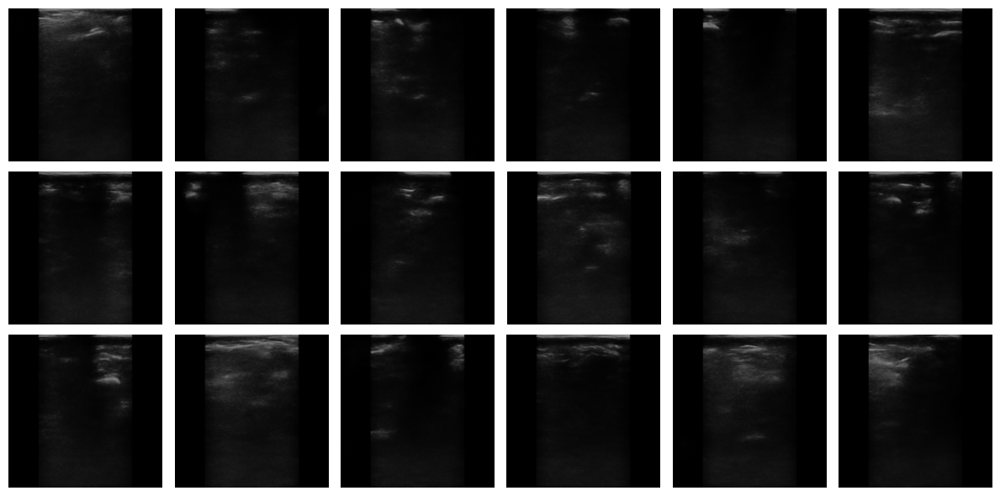

Epoch 1/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0447 - i_loss: 0.0700
Epoch 2/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0454 - i_loss: 0.0718
Epoch 3/10
204/204 [==============================] - 84s 410ms/step - n_loss: 0.0441 - i_loss: 0.0695
Epoch 4/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0447 - i_loss: 0.0707
Epoch 5/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0451 - i_loss: 0.0700
Epoch 6/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0452 - i_loss: 0.0709
Epoch 7/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0447 - i_loss: 0.0685
Epoch 8/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0453 - i_loss: 0.0695
Epoch 9/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0448 - i_loss: 0.0713
Epoch 10/10
204/204 [==============================] - 83s 409ms/step - n

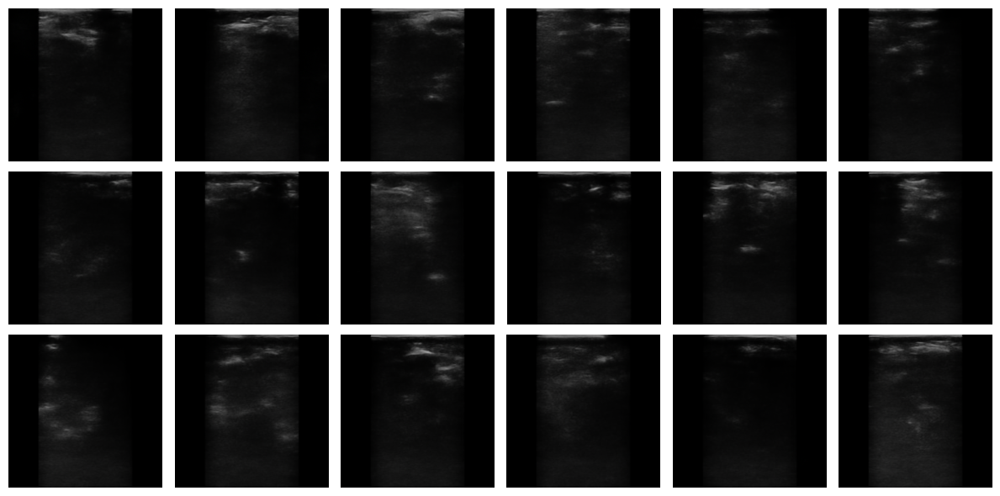

Epoch 1/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0447 - i_loss: 0.0700
Epoch 2/10
204/204 [==============================] - 84s 410ms/step - n_loss: 0.0442 - i_loss: 0.0711
Epoch 3/10
204/204 [==============================] - 84s 409ms/step - n_loss: 0.0442 - i_loss: 0.0709
Epoch 4/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0440 - i_loss: 0.0726
Epoch 5/10
204/204 [==============================] - 83s 408ms/step - n_loss: 0.0458 - i_loss: 0.0699
Epoch 6/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0453 - i_loss: 0.0699
Epoch 7/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0449 - i_loss: 0.0711
Epoch 8/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0451 - i_loss: 0.0692
Epoch 9/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0450 - i_loss: 0.0691
Epoch 10/10
204/204 [==============================] - 83s 409ms/step - n

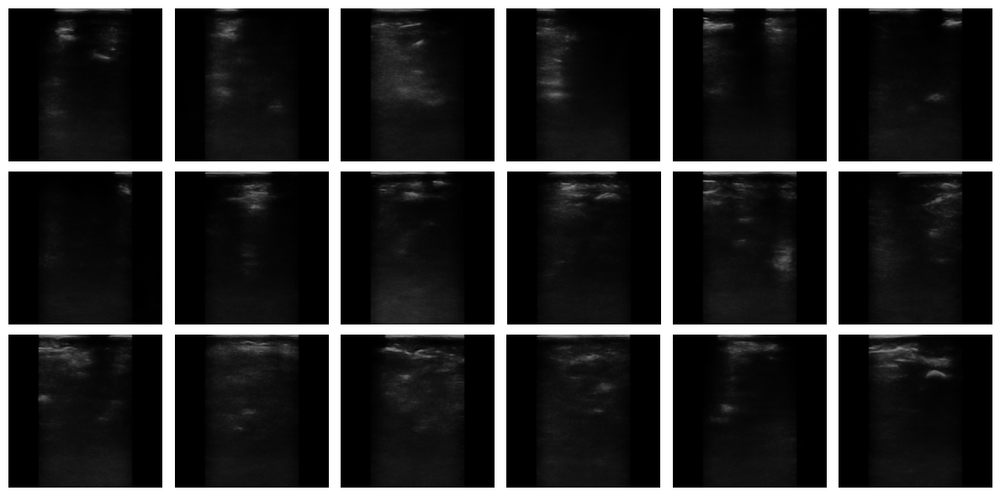

Epoch 1/10
204/204 [==============================] - 83s 408ms/step - n_loss: 0.0446 - i_loss: 0.0699
Epoch 2/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0448 - i_loss: 0.0688
Epoch 3/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0449 - i_loss: 0.0727
Epoch 4/10
204/204 [==============================] - 84s 410ms/step - n_loss: 0.0461 - i_loss: 0.0694
Epoch 5/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0454 - i_loss: 0.0695
Epoch 6/10
204/204 [==============================] - 84s 410ms/step - n_loss: 0.0449 - i_loss: 0.0701
Epoch 7/10
204/204 [==============================] - 84s 411ms/step - n_loss: 0.0442 - i_loss: 0.0705
Epoch 8/10
204/204 [==============================] - 84s 411ms/step - n_loss: 0.0453 - i_loss: 0.0701
Epoch 9/10
204/204 [==============================] - 84s 410ms/step - n_loss: 0.0444 - i_loss: 0.0699
Epoch 10/10
204/204 [==============================] - 84s 410ms/step - n

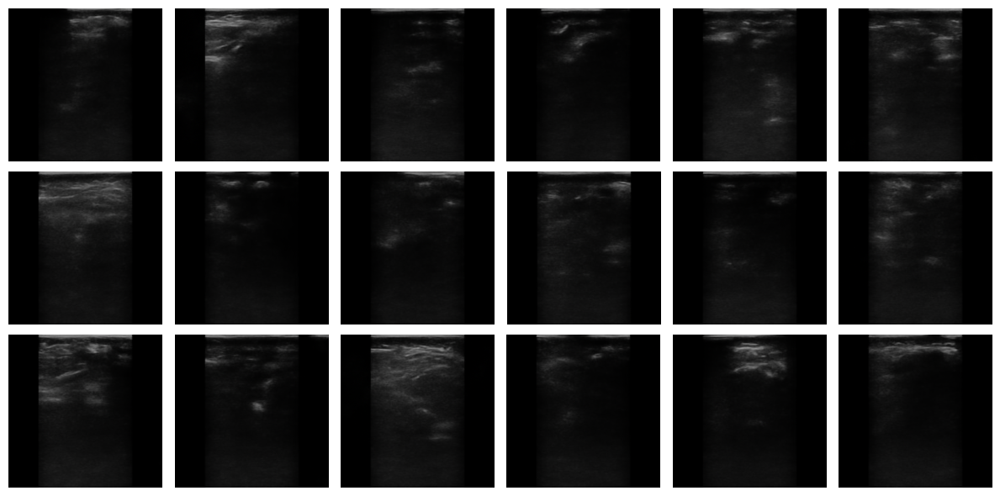

Epoch 1/10
204/204 [==============================] - 84s 410ms/step - n_loss: 0.0454 - i_loss: 0.0701
Epoch 2/10
204/204 [==============================] - 84s 410ms/step - n_loss: 0.0454 - i_loss: 0.0697
Epoch 3/10
204/204 [==============================] - 84s 410ms/step - n_loss: 0.0446 - i_loss: 0.0690
Epoch 4/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0446 - i_loss: 0.0698
Epoch 5/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0450 - i_loss: 0.0697
Epoch 6/10
204/204 [==============================] - 83s 408ms/step - n_loss: 0.0452 - i_loss: 0.0705
Epoch 7/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0452 - i_loss: 0.0701
Epoch 8/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0451 - i_loss: 0.0690
Epoch 9/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0446 - i_loss: 0.0710
Epoch 10/10
204/204 [==============================] - 83s 409ms/step - n

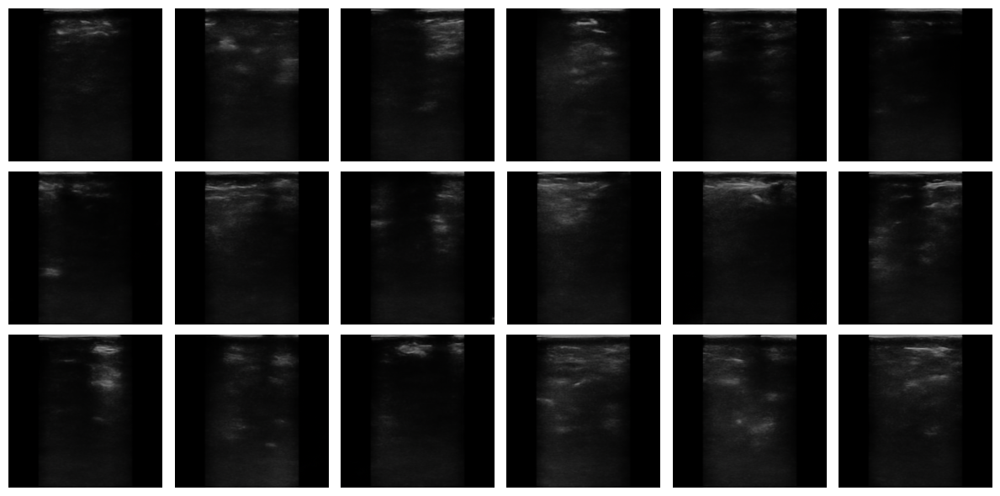

Epoch 1/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0450 - i_loss: 0.0684
Epoch 2/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0452 - i_loss: 0.0702
Epoch 3/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0454 - i_loss: 0.0703
Epoch 4/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0443 - i_loss: 0.0683
Epoch 5/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0456 - i_loss: 0.0688
Epoch 6/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0460 - i_loss: 0.0692
Epoch 7/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0451 - i_loss: 0.0690
Epoch 8/10
204/204 [==============================] - 83s 408ms/step - n_loss: 0.0446 - i_loss: 0.0707
Epoch 9/10
204/204 [==============================] - 83s 408ms/step - n_loss: 0.0459 - i_loss: 0.0701
Epoch 10/10
204/204 [==============================] - 83s 408ms/step - n

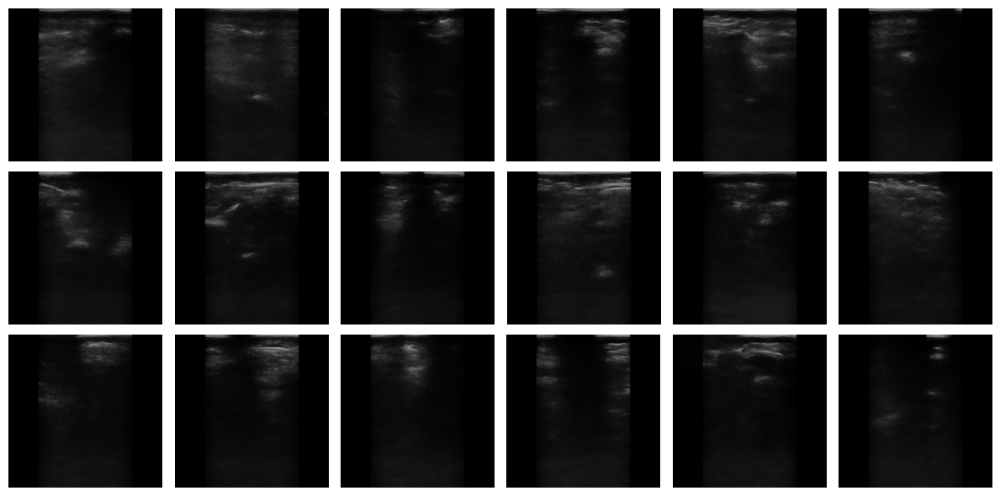

Epoch 1/10
204/204 [==============================] - 83s 408ms/step - n_loss: 0.0443 - i_loss: 0.0707
Epoch 2/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0441 - i_loss: 0.0709
Epoch 3/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0448 - i_loss: 0.0697
Epoch 4/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0449 - i_loss: 0.0692
Epoch 5/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0447 - i_loss: 0.0703
Epoch 6/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0440 - i_loss: 0.0701
Epoch 7/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0453 - i_loss: 0.0707
Epoch 8/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0451 - i_loss: 0.0696
Epoch 9/10
204/204 [==============================] - 83s 408ms/step - n_loss: 0.0449 - i_loss: 0.0707
Epoch 10/10
204/204 [==============================] - 83s 409ms/step - n

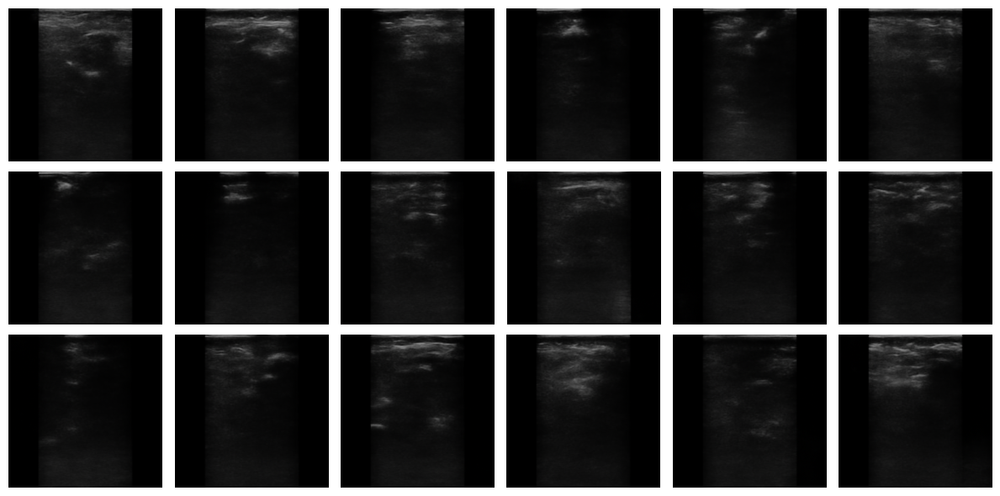

Epoch 1/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0449 - i_loss: 0.0694
Epoch 2/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0447 - i_loss: 0.0700
Epoch 3/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0447 - i_loss: 0.0721
Epoch 4/10
204/204 [==============================] - 84s 409ms/step - n_loss: 0.0457 - i_loss: 0.0705
Epoch 5/10
204/204 [==============================] - 84s 410ms/step - n_loss: 0.0444 - i_loss: 0.0685
Epoch 6/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0448 - i_loss: 0.0719
Epoch 7/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0448 - i_loss: 0.0697
Epoch 8/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0448 - i_loss: 0.0693
Epoch 9/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0445 - i_loss: 0.0721
Epoch 10/10
204/204 [==============================] - 84s 409ms/step - n

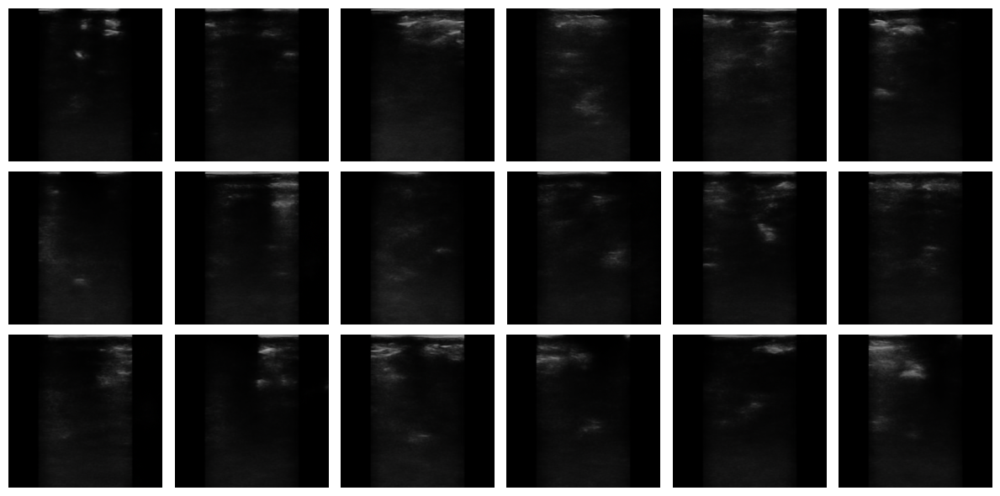

Epoch 1/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0450 - i_loss: 0.0697
Epoch 2/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0444 - i_loss: 0.0709
Epoch 3/10
204/204 [==============================] - 84s 410ms/step - n_loss: 0.0452 - i_loss: 0.0686
Epoch 4/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0443 - i_loss: 0.0708
Epoch 5/10
204/204 [==============================] - 84s 410ms/step - n_loss: 0.0445 - i_loss: 0.0720
Epoch 6/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0439 - i_loss: 0.0710
Epoch 7/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0447 - i_loss: 0.0706
Epoch 8/10
204/204 [==============================] - 84s 410ms/step - n_loss: 0.0448 - i_loss: 0.0705
Epoch 9/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0453 - i_loss: 0.0696
Epoch 10/10
204/204 [==============================] - 83s 409ms/step - n

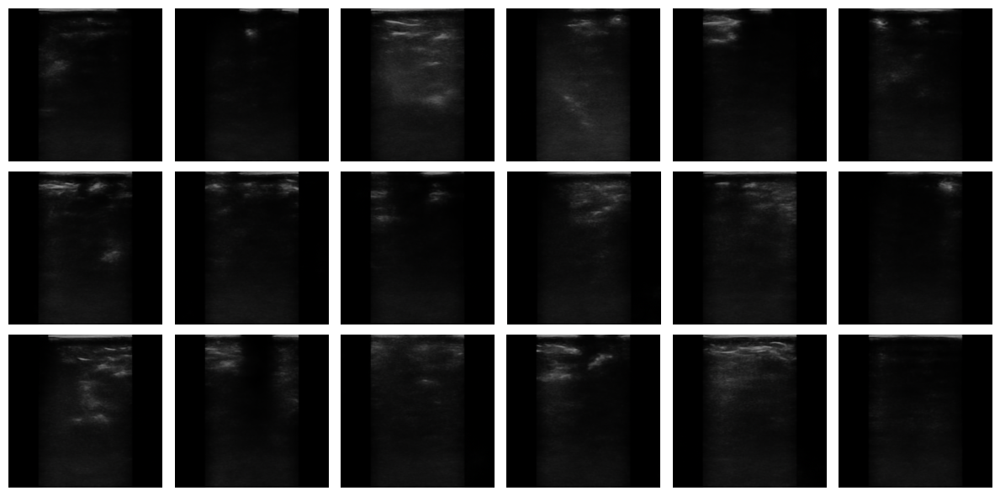

Epoch 1/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0449 - i_loss: 0.0688
Epoch 2/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0445 - i_loss: 0.0694
Epoch 3/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0441 - i_loss: 0.0721
Epoch 4/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0450 - i_loss: 0.0710
Epoch 5/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0456 - i_loss: 0.0692
Epoch 6/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0447 - i_loss: 0.0706
Epoch 7/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0451 - i_loss: 0.0720
Epoch 8/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0454 - i_loss: 0.0693
Epoch 9/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0451 - i_loss: 0.0684
Epoch 10/10
204/204 [==============================] - 83s 409ms/step - n

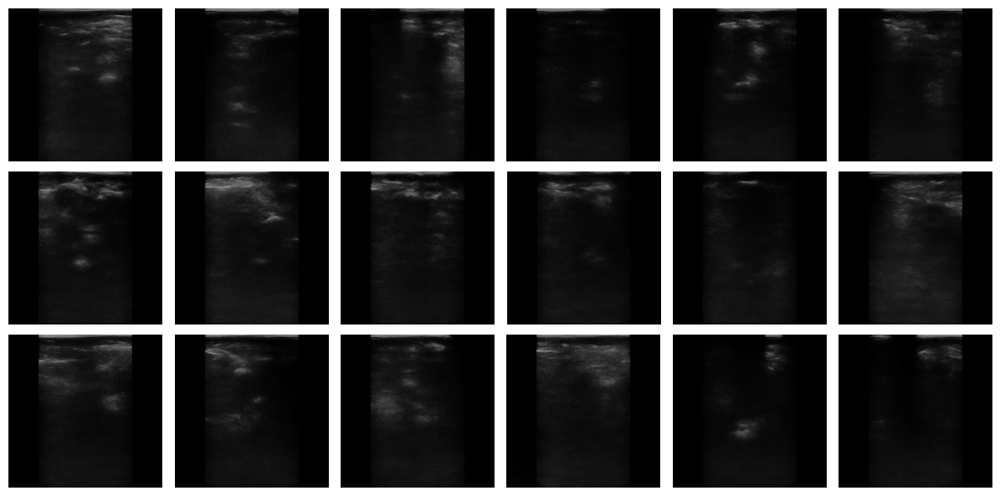

Epoch 1/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0450 - i_loss: 0.0705
Epoch 2/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0446 - i_loss: 0.0707
Epoch 3/10
204/204 [==============================] - 83s 408ms/step - n_loss: 0.0454 - i_loss: 0.0700
Epoch 4/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0447 - i_loss: 0.0702
Epoch 5/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0455 - i_loss: 0.0688
Epoch 6/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0452 - i_loss: 0.0702
Epoch 7/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0449 - i_loss: 0.0704
Epoch 8/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0454 - i_loss: 0.0711
Epoch 9/10
204/204 [==============================] - 84s 410ms/step - n_loss: 0.0442 - i_loss: 0.0716
Epoch 10/10
204/204 [==============================] - 84s 410ms/step - n

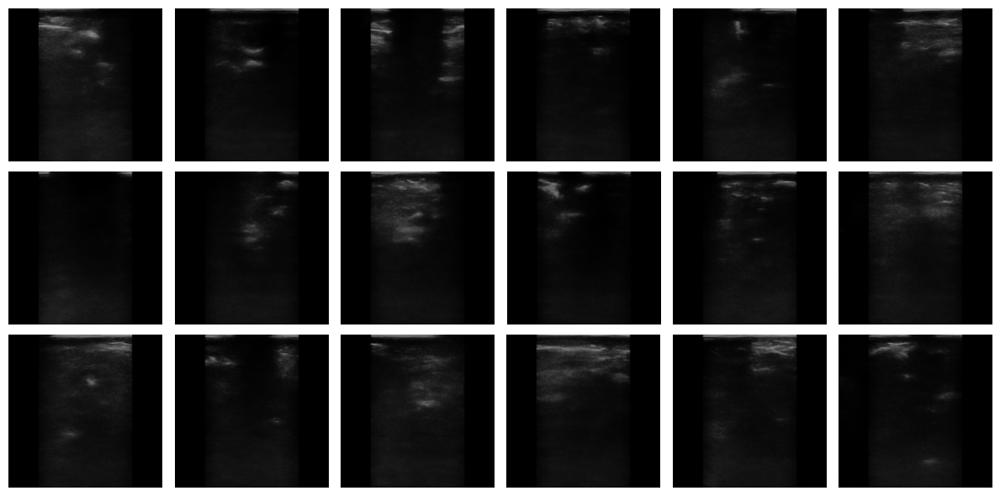

Epoch 1/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0451 - i_loss: 0.0702
Epoch 2/10
204/204 [==============================] - 84s 409ms/step - n_loss: 0.0443 - i_loss: 0.0710
Epoch 3/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0452 - i_loss: 0.0707
Epoch 4/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0459 - i_loss: 0.0692
Epoch 5/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0460 - i_loss: 0.0681
Epoch 6/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0458 - i_loss: 0.0704
Epoch 7/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0452 - i_loss: 0.0696
Epoch 8/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0448 - i_loss: 0.0697
Epoch 9/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0444 - i_loss: 0.0715
Epoch 10/10
204/204 [==============================] - 83s 409ms/step - n

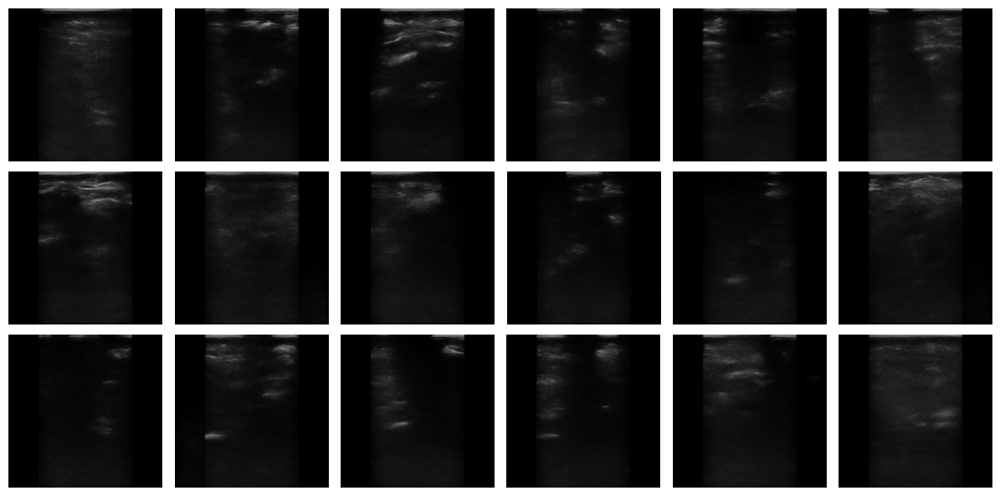

Epoch 1/10
204/204 [==============================] - 83s 408ms/step - n_loss: 0.0457 - i_loss: 0.0686
Epoch 2/10
204/204 [==============================] - 83s 408ms/step - n_loss: 0.0451 - i_loss: 0.0708
Epoch 3/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0457 - i_loss: 0.0697
Epoch 4/10
204/204 [==============================] - 83s 408ms/step - n_loss: 0.0446 - i_loss: 0.0713
Epoch 5/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0453 - i_loss: 0.0693
Epoch 6/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0441 - i_loss: 0.0706
Epoch 7/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0448 - i_loss: 0.0708
Epoch 8/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0463 - i_loss: 0.0704
Epoch 9/10
204/204 [==============================] - 83s 409ms/step - n_loss: 0.0444 - i_loss: 0.0691
Epoch 10/10
204/204 [==============================] - 83s 409ms/step - n

In [7]:
import tensorflow_addons as tfa
# create and compile the model
model = DiffusionModel(image_size, widths, block_depth)
# below tensorflow 2.9:
# pip install tensorflow_addons

# optimizer=tfa.optimizers.AdamW
model.compile(
    optimizer=tfa.optimizers.AdamW(
        learning_rate=learning_rate, weight_decay=weight_decay
    ),
    loss=keras.losses.mean_absolute_error,
)
# pixelwise mean absolute error is used as loss

# save the best model based on the validation KID metric
checkpoint_path = "../../model/Diffusion/checkpoints_diffusion_model.tf"
checkpoint_callback = tf.keras.callbacks.ModelCheckpoint(
    filepath=checkpoint_path,
    save_weights_only=True,
    monitor="val_kid",
    mode="min",
    save_best_only=True,
)

# calculate mean and variance of training dataset for normalization
model.normalizer.adapt(tf_train_x)
# run training and plot generated images periodically
for i in range(1000):
    model.plot_images()
    model.fit(
    tf_train_x,
    epochs=10)
    model.save_weights("../../model/Diffusion/diffusion_model_"+str(i)+".tf")